In [1]:
!pip install plotly==5.11.0
!pip install -U kaleido
!pip install imbalanced-learn

import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
import seaborn as sn
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
from tqdm.notebook import tqdm
import plotly.graph_objects as go
import plotly.express as px
from sklearn.preprocessing import StandardScaler

#connecting with drive

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


#read in csv file

In [2]:
import numpy as np
import pandas as pd

#df = pd.read_csv("/content/drive/MyDrive/Sleep_Research/draft/HMC_Sleep_Stages.csv")
df = pd.read_csv("C:/Users/RAZER/Downloads/dataset/HMC_Sleep_Stages.csv")

In [3]:
df.head()

,Subject,Sleep_Stage,Epoch,MeanP_Alpha_F4,MedianF_Alpha_F4,MeanF_Alpha_F4,SpectralEdge_Alpha_F4,PeakF_Alpha_F4,MeanP_Beta_F4,MedianF_Beta_F4,...,MeanP_Delta_O2,MedianF_Delta_O2,MeanF_Delta_O2,SpectralEdge_Delta_O2,PeakF_Delta_O2,MeanP_Gamma_O2,MedianF_Gamma_O2,MeanF_Gamma_O2,SpectralEdge_Gamma_O2,PeakF_Gamma_O2
0,SN002,N1,6,0.00034,10.11512,17.85756,17.48293,10.24000,0.00047,17.73268,...,0.00112,0.74927,6.36878,2.87220,0.62439,0.000076,32.71805,43.83220,49.95122,49.95122
1,SN002,N1,7,0.00035,10.73951,17.60780,17.10829,9.11610,0.00048,16.85854,...,0.00070,0.99902,6.86829,3.62146,0.74927,0.000072,32.09366,44.33171,49.95122,49.95122
2,SN002,N1,8,0.00035,9.36585,17.60780,16.98341,9.24098,0.00042,17.35805,...,0.00077,1.49854,6.49366,4.12098,0.74927,0.000069,33.09268,43.95707,49.95122,49.95122
3,SN002,N1,116,0.00054,9.74049,15.98439,15.48488,8.36683,0.00051,14.61073,...,0.00082,0.87415,7.49268,3.49659,0.87415,0.000039,28.34732,43.08293,49.95122,49.95122
4,SN002,N1,117,0.00034,10.11512,16.48390,15.98439,12.23805,0.00034,15.11024,...,0.00084,0.87415,6.86829,2.87220,0.62439,0.000032,28.97171,43.20780,49.95122,49.95122


In [4]:
df.isnull().sum()

Subject                  0
Sleep_Stage              0
Epoch                    0
MeanP_Alpha_F4           0
MedianF_Alpha_F4         0
                        ..
MeanP_Gamma_O2           0
MedianF_Gamma_O2         0
MeanF_Gamma_O2           0
SpectralEdge_Gamma_O2    0
PeakF_Gamma_O2           0
Length: 78, dtype: int64

In [5]:
df = df.dropna().reset_index(drop=True)

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 108451 entries, 0 to 108450
Data columns (total 78 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   Subject                108451 non-null  object 
 1   Sleep_Stage            108451 non-null  object 
 2   Epoch                  108451 non-null  int64  
 3   MeanP_Alpha_F4         108451 non-null  float64
 4   MedianF_Alpha_F4       108451 non-null  float64
 5   MeanF_Alpha_F4         108451 non-null  float64
 6   SpectralEdge_Alpha_F4  108451 non-null  float64
 7   PeakF_Alpha_F4         108451 non-null  float64
 8   MeanP_Beta_F4          108451 non-null  float64
 9   MedianF_Beta_F4        108451 non-null  float64
 10  MeanF_Beta_F4          108451 non-null  float64
 11  SpectralEdge_Beta_F4   108451 non-null  float64
 12  PeakF_Beta_F4          108451 non-null  float64
 13  MeanP_Theta_F4         108451 non-null  float64
 14  MedianF_Theta_F4       108451 non-nu

In [7]:
df.shape

(108451, 78)

#Converting N1,N2 -> Light_Sleep, N3 -> Deep_Sleep And removing W stage and R Stage.

In [8]:
df =df.replace("N1", "Light_Sleep")
df =df.replace("N2", "Light_Sleep")
df =df.replace("N3", "Deep_Sleep")
df.drop(df.index[df['Sleep_Stage'] == "R"], inplace = True)
df.drop(df.index[df['Sleep_Stage'] == "W"], inplace = True)

In [9]:
df.head()

,Subject,Sleep_Stage,Epoch,MeanP_Alpha_F4,MedianF_Alpha_F4,MeanF_Alpha_F4,SpectralEdge_Alpha_F4,PeakF_Alpha_F4,MeanP_Beta_F4,MedianF_Beta_F4,...,MeanP_Delta_O2,MedianF_Delta_O2,MeanF_Delta_O2,SpectralEdge_Delta_O2,PeakF_Delta_O2,MeanP_Gamma_O2,MedianF_Gamma_O2,MeanF_Gamma_O2,SpectralEdge_Gamma_O2,PeakF_Gamma_O2
0,SN002,Light_Sleep,6,0.00034,10.11512,17.85756,17.48293,10.24000,0.00047,17.73268,...,0.00112,0.74927,6.36878,2.87220,0.62439,0.000076,32.71805,43.83220,49.95122,49.95122
1,SN002,Light_Sleep,7,0.00035,10.73951,17.60780,17.10829,9.11610,0.00048,16.85854,...,0.00070,0.99902,6.86829,3.62146,0.74927,0.000072,32.09366,44.33171,49.95122,49.95122
2,SN002,Light_Sleep,8,0.00035,9.36585,17.60780,16.98341,9.24098,0.00042,17.35805,...,0.00077,1.49854,6.49366,4.12098,0.74927,0.000069,33.09268,43.95707,49.95122,49.95122
3,SN002,Light_Sleep,116,0.00054,9.74049,15.98439,15.48488,8.36683,0.00051,14.61073,...,0.00082,0.87415,7.49268,3.49659,0.87415,0.000039,28.34732,43.08293,49.95122,49.95122
4,SN002,Light_Sleep,117,0.00034,10.11512,16.48390,15.98439,12.23805,0.00034,15.11024,...,0.00084,0.87415,6.86829,2.87220,0.62439,0.000032,28.97171,43.20780,49.95122,49.95122


In [10]:
df.shape

(72631, 78)

#Removing columns

In [11]:
df = df.loc[:,df.columns != "Subject"]
df = df.loc[:,df.columns != "Epoch"]

#All Columns Histogram

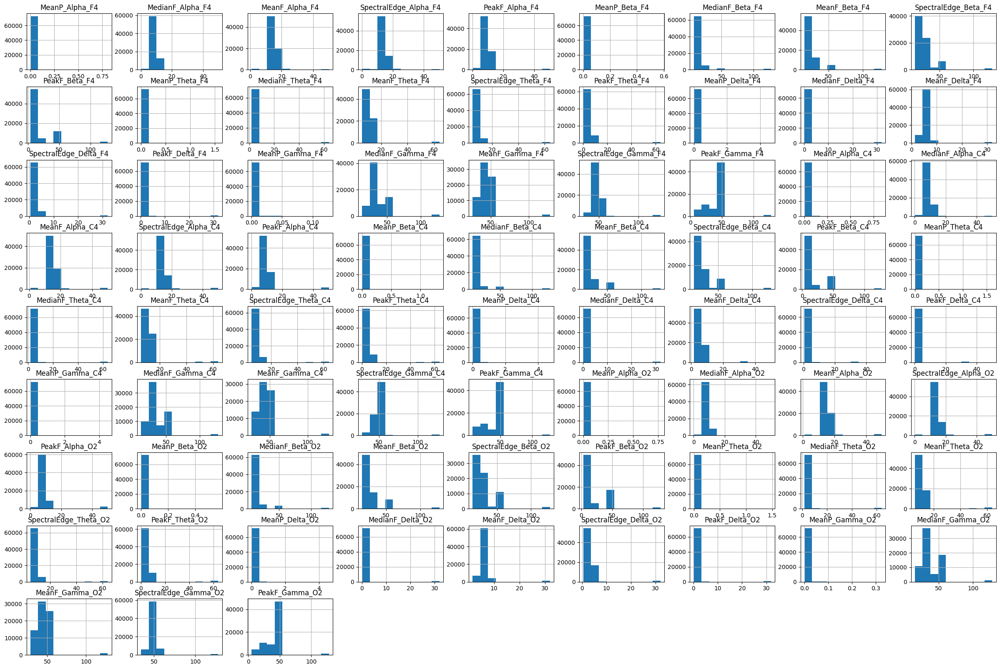

In [ ]:
from matplotlib import pyplot
from pandas import read_csv

df.hist(figsize=(30,20))
pyplot.show()

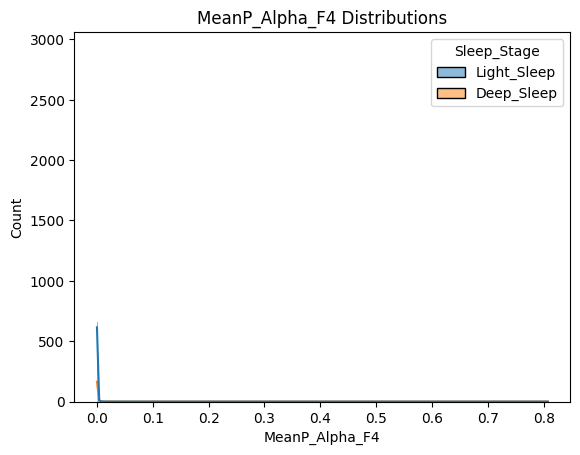

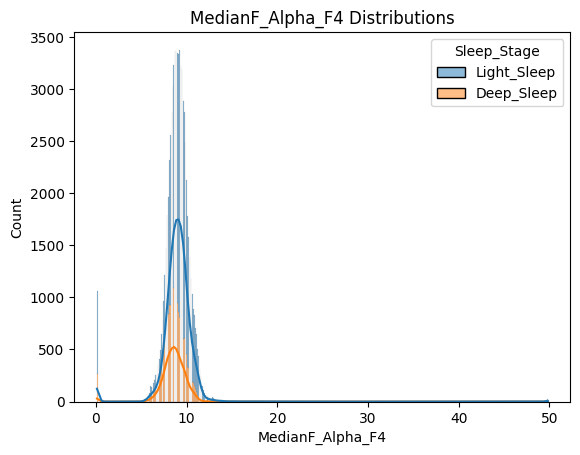

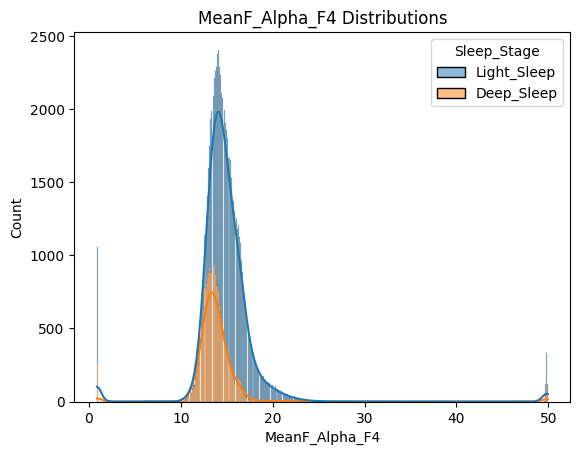

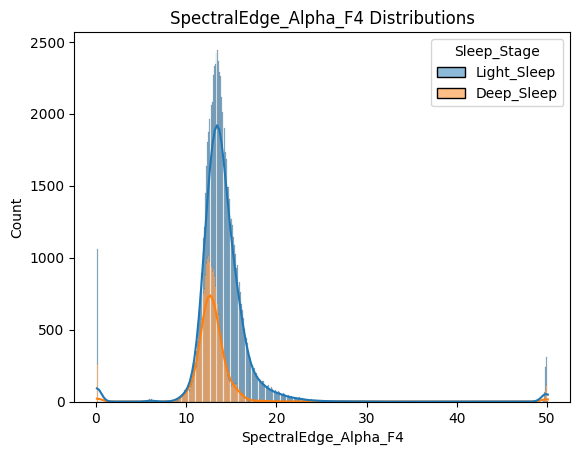

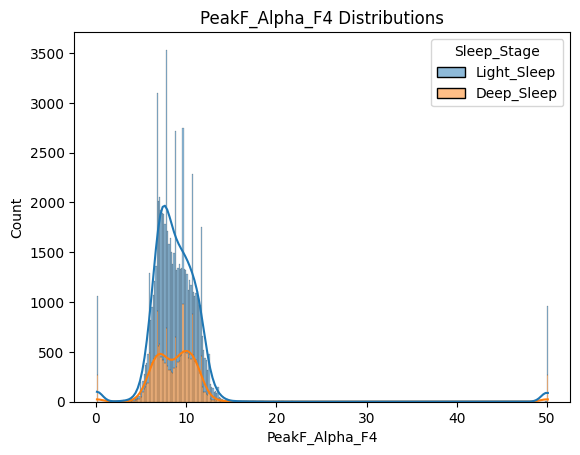

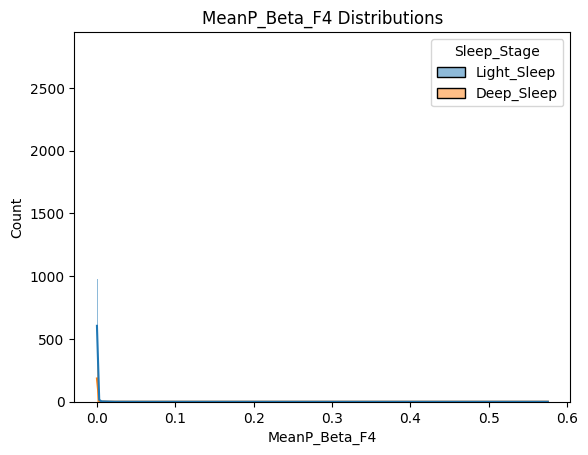

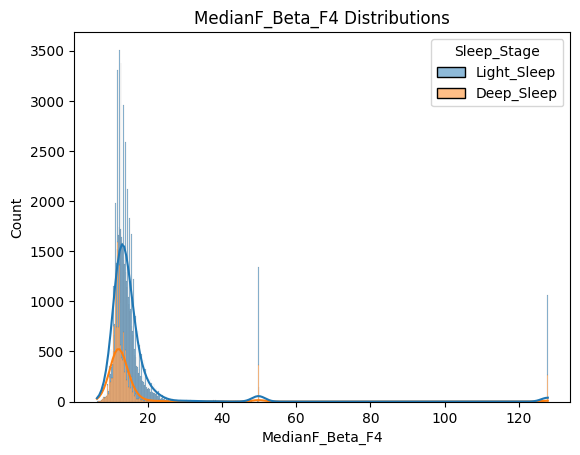

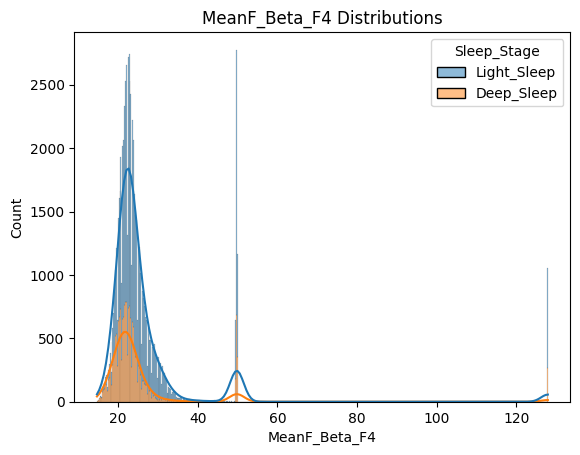

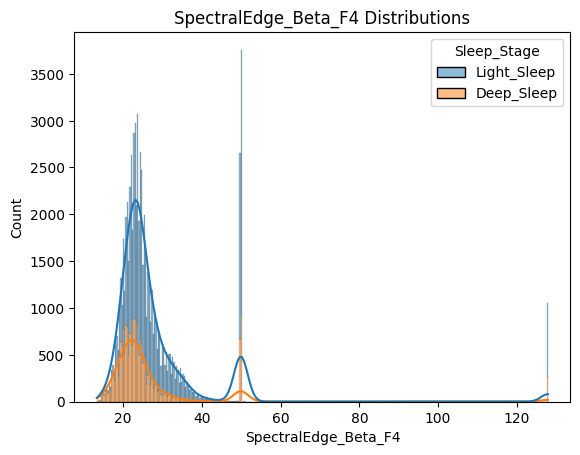

In [ ]:

numeric_col = list(df.loc[:,df.columns!="Sleep_Stage"].columns)

for i in numeric_col[0:9]:
  plt.figure()
  sns.histplot(data=df,x=i, hue="Sleep_Stage",kde = True, multiple="stack")
  plt.title(i+" Distributions")
  plt.show()


#Encoding target columns (Sleep Stage)

In [12]:
target="Sleep_Stage"

In [13]:
from sklearn.preprocessing import LabelEncoder
encd = LabelEncoder()

In [14]:
df[target] = encd.fit_transform(df[target])

In [15]:
df[target].value_counts()

1    51341
0    21290
Name: Sleep_Stage, dtype: int64

<AxesSubplot: xlabel='Sleep_Stage', ylabel='count'>

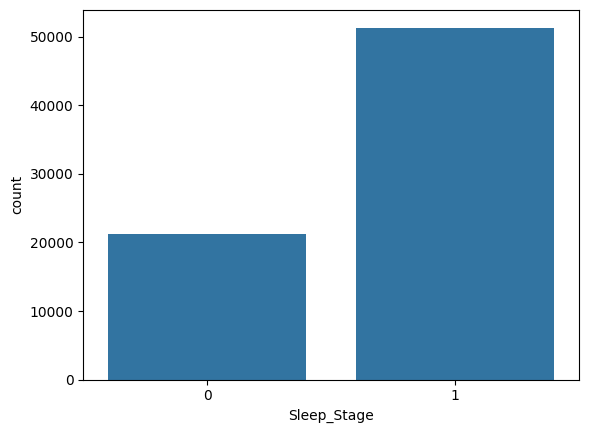

In [16]:
import matplotlib.pyplot as plt
import seaborn as sns

sns.countplot(x="Sleep_Stage",data=df)

#Feature Selections Methods

In [17]:
from sklearn.datasets import make_classification
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import f_classif
from sklearn.datasets import make_regression
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import f_regression
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2


#ANOVA
def anova(X,y,num_of_feat):
  fs = SelectKBest(score_func=f_classif, k=5)
  fit = fs.fit(X,y)
  dfscores = pd.DataFrame(fit.scores_)
  dfcolumns = pd.DataFrame(X.columns)

  featureScores = pd.concat([dfcolumns,dfscores],axis=1)

  featureScores.columns = ['Best_columns','Score_ANOVA']

  lyst = featureScores.nlargest(num_of_feat,'Score_ANOVA')
  ANOVA_feature=list(lyst['Best_columns'])
  return ANOVA_feature



#PEARSON
def pearson(X,y,num_of_feat):
  fs = SelectKBest(score_func=f_regression, k=5)
  fit = fs.fit(X,y)

  #create df for scores
  dfscores = pd.DataFrame(fit.scores_)
  #create df for column names
  dfcolumns = pd.DataFrame(df.columns)
  #concat two dataframes for better visualization
  featureScores = pd.concat([dfcolumns,dfscores],axis=1)
  #naming the dataframe columns
  featureScores.columns = ['Best_columns','Score_pearsons']

  #print 10 best features
  lyst = featureScores.nlargest(num_of_feat,'Score_pearsons')

  PEARSON_feature=list(lyst['Best_columns'])
  return PEARSON_feature




#Univarient
def uni(X,y,num_of_feat):
  bestfeatures = SelectKBest(score_func=chi2, k=10)
  fit = bestfeatures.fit(X,y)

  dfscores = pd.DataFrame(fit.scores_)
  dfcolumns = pd.DataFrame(X.columns)


  #concat two dataframes for better visualization
  featureScores = pd.concat([dfcolumns,dfscores],axis=1)
  featureScores.columns = ['Specs','Score']  #naming the dataframe columns



  sorted_df = featureScores.sort_values(by=['Score'], ascending=False)
  Univarient_feature = sorted_df["Specs"][:num_of_feat]
  return Univarient_feature

In [ ]:
from sklearn.preprocessing import StandardScaler
from imblearn.over_sampling import SMOTE
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
from tqdm.notebook import tqdm

col_number = [10,15,20,25,30,35,40,45,50,55,60,65,70]
anova_accu = []
pear_accu = []
uni_accu = []


for i in tqdm(col_number):

  anova_col_name = anova(df.loc[:,df.columns != target],df[target],i)
  pear_col_name = pearson(df.loc[:,df.columns != target],df[target],i)
  uni_col_name = uni(df.loc[:,df.columns != target],df[target],i)

  anova_X = df.loc[:,anova_col_name]
  pear_X = df.loc[:,pear_col_name]
  uni_X = df.loc[:,uni_col_name]
  y = df[target]
  list_X = [("anova",anova_X),("pearson",pear_X),("univarient",uni_X)]

  for method,X in list_X:

    scaler = StandardScaler()
    scaler.fit(X)
    X[X.columns] = scaler.transform(X)

    X_train, X_test_val, y_train, y_test_val= train_test_split(X,y, test_size=0.3,random_state=42)
    X_test, X_val, y_test, y_val= train_test_split(X_test_val, y_test_val, train_size=.5, random_state=42)

    smote = SMOTE()
    X_train,y_train = smote.fit_resample(X_train,y_train)

    rf = RandomForestClassifier()
    rf.fit(X_train, y_train)
    y_pred_test = rf.predict(X_test)

    ts_accu = accuracy_score(y_test, y_pred_test)

    print("-----------------------------------------------------------------------")
    print("Feature Selectiokn Method: ",method)
    print("Number of Features: ",i)
    print("Accuracy: ",ts_accu)
    print("-----------------------------------------------------------------------")

    if method=="anova":
      anova_accu.append(ts_accu)
    elif method=="pearson":
      pear_accu.append(ts_accu)
    elif method=="univarient":
      uni_accu.append(ts_accu)
  print("__________________________________________________________________________________________________________________________________________________________")

  0%|          | 0/13 [00:00<?, ?it/s]

-----------------------------------------------------------------------
Feature Selectiokn Method:  anova
Number of Features:  10
Accurecy:  0.865167508031207
-----------------------------------------------------------------------
-----------------------------------------------------------------------
Feature Selectiokn Method:  pearson
Number of Features:  10
Accurecy:  0.8425883432767325
-----------------------------------------------------------------------
-----------------------------------------------------------------------
Feature Selectiokn Method:  univarient
Number of Features:  10
Accurecy:  0.8544286369894447
-----------------------------------------------------------------------
__________________________________________________________________________________________________________________________________________________________
-----------------------------------------------------------------------
Feature Selectiokn Method:  anova
Number of Features:  15
Accurecy:  0.

#

###Making a Feature Selection Records dataset and save it.
It takes long time to complete the feature selectiion approch. So we make a dataset so that we do not have to run the feature selection cell every time.

In [ ]:
df_feat = pd.DataFrame(columns =['Method', 'Number_of_feature','Accuracy'])


df_feat['Method'] = ["Anova","Anova","Anova","Anova","Anova","Anova","Anova","Anova","Anova","Anova","Anova","Anova","Anova",
                     "Pearson","Pearson","Pearson","Pearson","Pearson","Pearson","Pearson","Pearson","Pearson","Pearson","Pearson","Pearson","Pearson",
                     "Univarient","Univarient","Univarient","Univarient","Univarient","Univarient","Univarient","Univarient","Univarient","Univarient","Univarient","Univarient","Univarient",]
df_feat['Number_of_feature'] = col_number+col_number+col_number
df_feat['Accuracy'] = anova_accu+pear_accu+uni_accu

df_feat.to_csv("Feature_Selection_Records.csv",index=False)




In [ ]:
df_feat

,Method,Number_of_feature,Accurecy
0,Anova,10,0.865168
1,Anova,15,0.880128
2,Anova,20,0.883066
3,Anova,25,0.884810
4,Anova,30,0.885177
5,Anova,35,0.889674
6,Anova,40,0.894906
7,Anova,45,0.898669
8,Anova,50,0.901514
9,Anova,55,0.903809


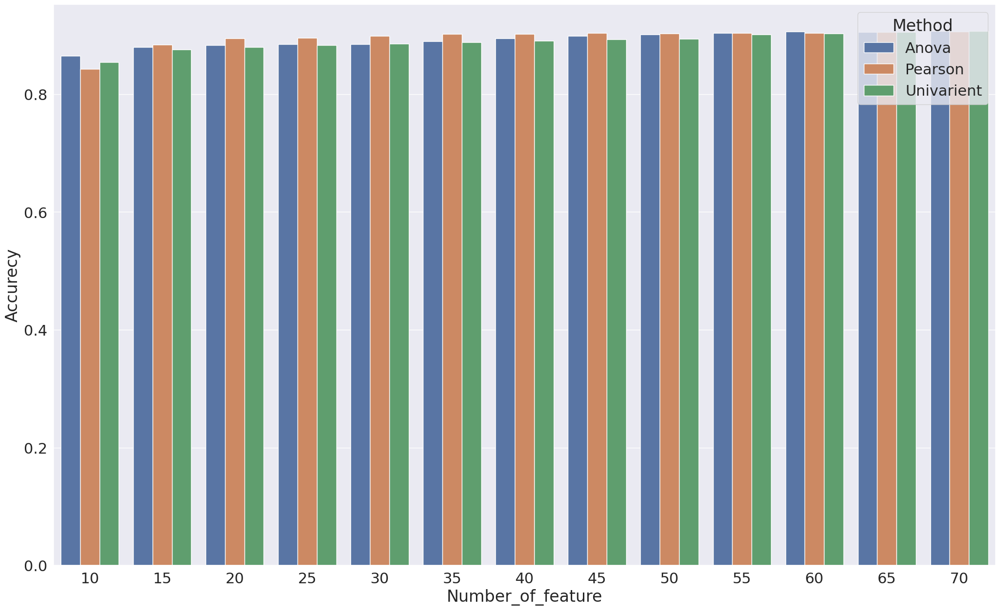

In [ ]:

fig, ax = plt.subplots(figsize=(25, 15))
sns.set_style("darkgrid")
sns.set(font_scale = 2)
cx = sns.barplot(df_feat, x="Number_of_feature", y="Accuracy", hue="Method",errwidth=0,ax=ax)

In [ ]:
df_feat.sort_values('Accuracy', ascending=False)

,Method,Number_of_feature,Accurecy
38,Univarient,70,0.906838
12,Anova,70,0.906838
25,Pearson,70,0.906379
10,Anova,60,0.906287
37,Univarient,65,0.905645
24,Pearson,65,0.905094
11,Anova,65,0.905094
22,Pearson,55,0.903993
9,Anova,55,0.903809
23,Pearson,60,0.903534


The max accurecy obtained is  90%. 35 columns selected with Pearson feature selection method is the optimum result.

In [18]:
X=df.loc[:,df.columns!=target]
y=df[target]


fs = SelectKBest(score_func=f_regression, k=5)
fit = fs.fit(X,y)

#create df for scores
dfscores = pd.DataFrame(fit.scores_)
#create df for column names
dfcolumns = pd.DataFrame(df.columns)
#concat two dataframes for better visualization
featureScores = pd.concat([dfcolumns,dfscores],axis=1)
#naming the dataframe columns
featureScores.columns = ['Best_columns','Score_pearsons']

#print 10 best features
lyst = featureScores.nlargest(35,'Score_pearsons')

PEARSON_feature=list(lyst['Best_columns'])

In [19]:
lyst

,Best_columns,Score_pearsons
3,MeanF_Alpha_F4,2081.855536
2,MedianF_Alpha_F4,1959.214962
51,MeanP_Alpha_O2,1435.565283
42,MedianF_Delta_C4,1417.481898
17,MedianF_Delta_F4,1239.603556
1,MeanP_Alpha_F4,1174.735459
67,MedianF_Delta_O2,1123.514069
28,MeanF_Alpha_C4,1003.270236
27,MedianF_Alpha_C4,953.657159
8,MeanF_Beta_F4,689.531196


###Best Features with Pearson Feature Selection Score

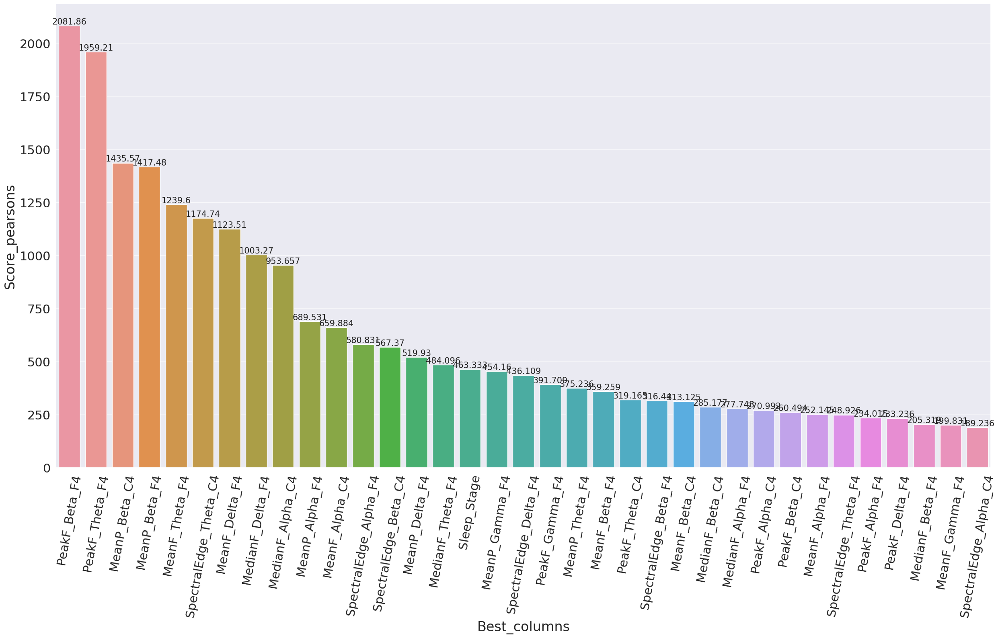

In [ ]:

fig, ax = plt.subplots(figsize=(30, 15))
ax.tick_params(axis='x', rotation=80)
cx = sns.barplot(lyst, x="Best_columns", y="Score_pearsons", estimator="sum", errorbar=None,ax=ax)
cx.bar_label(ax.containers[0], fontsize=15);

#Defining New Dataset with Selected Features

In [20]:
df = df.loc[:,["Sleep_Stage"]+PEARSON_feature]

In [21]:
df

,Sleep_Stage,MeanF_Alpha_F4,MedianF_Alpha_F4,MeanP_Alpha_O2,MedianF_Delta_C4,MedianF_Delta_F4,MeanP_Alpha_F4,MedianF_Delta_O2,MeanF_Alpha_C4,MedianF_Alpha_C4,...,SpectralEdge_Beta_C4,MeanF_Theta_C4,MedianF_Theta_C4,SpectralEdge_Beta_F4,MeanP_Theta_C4,MeanP_Beta_C4,MeanF_Beta_O2,MeanP_Beta_O2,MeanP_Theta_F4,MeanP_Theta_O2
0,1,17.85756,10.11512,0.00023,0.87415,0.74927,0.00034,0.74927,18.48195,9.86537,...,27.22341,12.11317,5.86927,27.47317,0.00048,0.00054,25.84976,0.00034,0.00041,0.00025
1,1,17.60780,10.73951,0.00023,0.87415,0.74927,0.00035,0.99902,19.60585,10.48976,...,27.09854,12.98732,5.61951,26.97366,0.00051,0.00064,26.22439,0.00032,0.00040,0.00027
2,1,17.60780,9.36585,0.00025,1.62341,0.99902,0.00035,1.49854,17.35805,8.99122,...,27.97268,10.61463,5.12000,28.47220,0.00078,0.00047,26.47415,0.00031,0.00052,0.00036
3,1,15.98439,9.74049,0.00029,0.87415,0.74927,0.00054,0.87415,17.10829,10.24000,...,23.10244,12.98732,6.49366,22.47805,0.00059,0.00064,22.72780,0.00030,0.00058,0.00033
4,1,16.48390,10.11512,0.00020,0.74927,0.62439,0.00034,0.87415,17.10829,9.86537,...,23.85171,12.36293,6.24390,23.47707,0.00042,0.00040,22.97756,0.00023,0.00044,0.00021
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
72626,0,15.23512,9.49073,0.00027,0.99902,0.99902,0.00027,0.99902,14.73561,9.61561,...,22.60293,11.11415,4.24585,23.72683,0.00059,0.00022,22.60293,0.00021,0.00061,0.00061
72627,0,15.60976,9.61561,0.00024,0.99902,0.74927,0.00024,0.74927,15.23512,8.61659,...,22.85268,10.48976,3.87122,23.85171,0.00068,0.00019,22.85268,0.00020,0.00056,0.00056
72628,0,15.36000,10.24000,0.00026,0.87415,0.74927,0.00026,0.74927,15.23512,10.24000,...,22.97756,11.48878,4.62049,23.60195,0.00046,0.00021,22.72780,0.00022,0.00051,0.00051
72629,0,15.36000,8.61659,0.00026,0.99902,0.87415,0.00026,0.87415,15.36000,8.36683,...,23.85171,10.86439,4.12098,24.10146,0.00058,0.00018,22.97756,0.00020,0.00056,0.00056


#Corelation Matrix

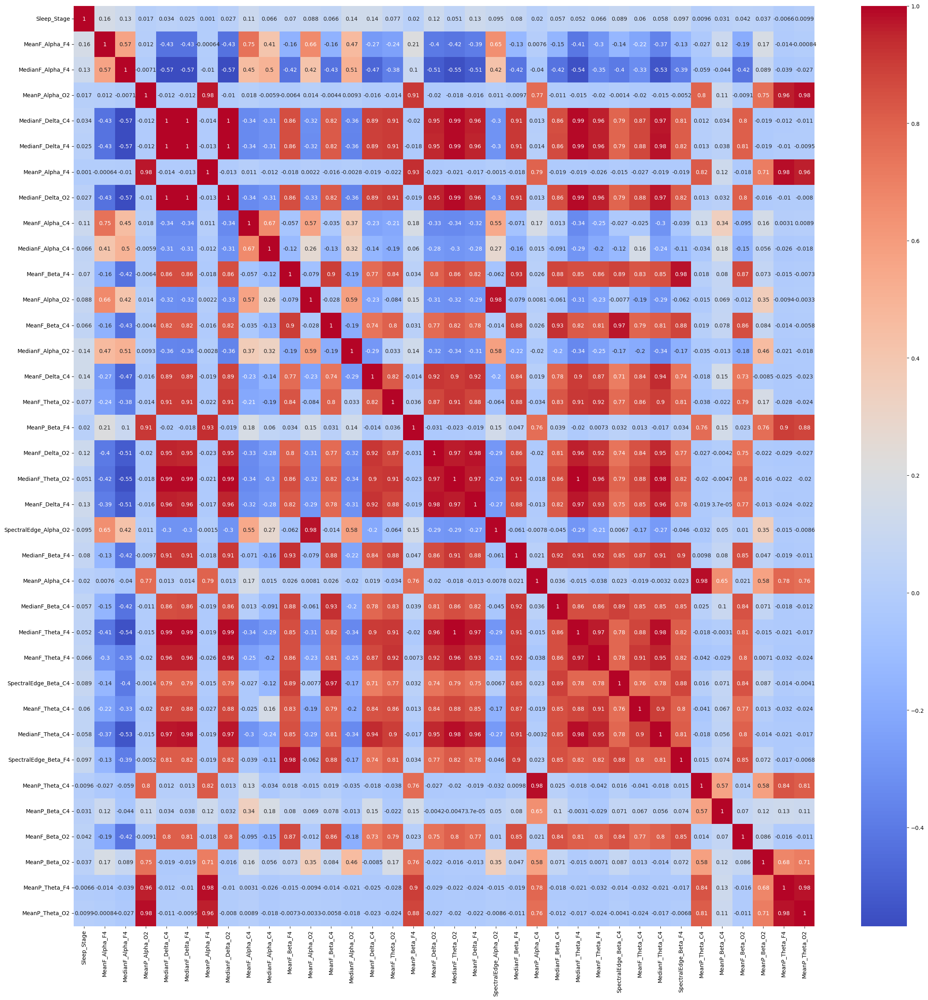

In [ ]:
correlation_Sleep_Stage = df.corr()
plt.figure(figsize=(30,30))
sns.heatmap(correlation_Sleep_Stage, annot=True, cmap="coolwarm")
plt.show()

#Histogram for Top 10 Features

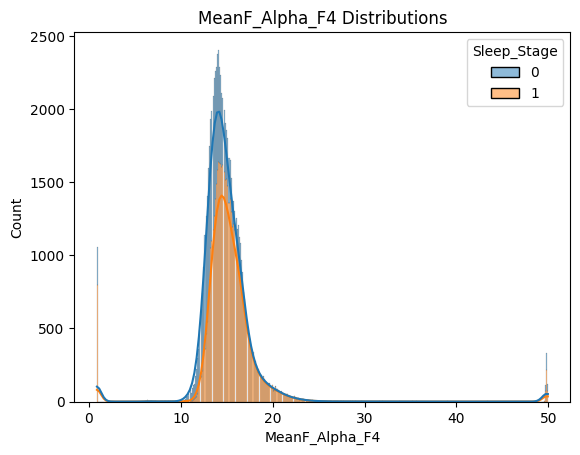

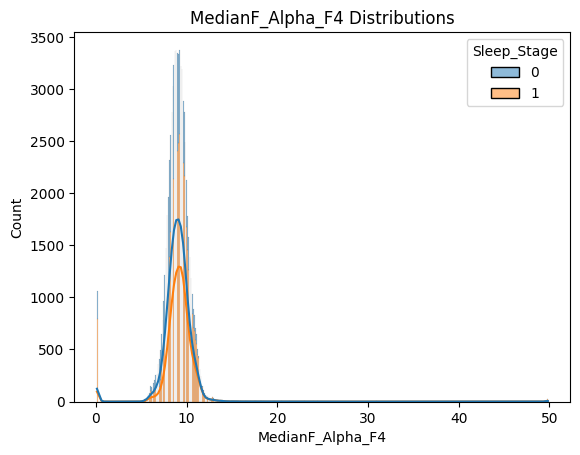

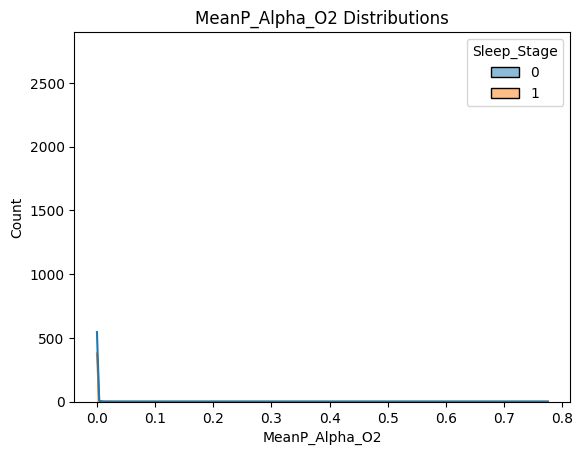

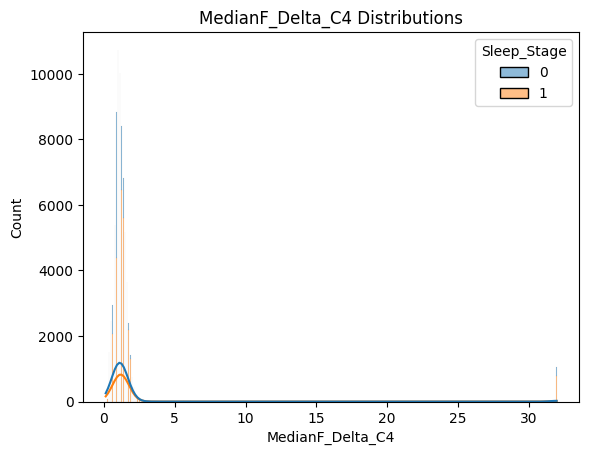

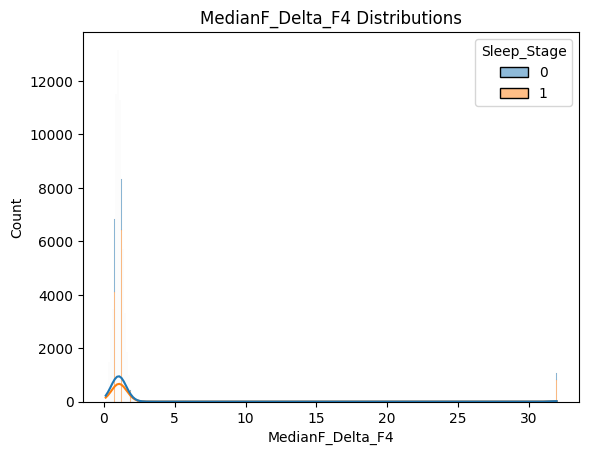

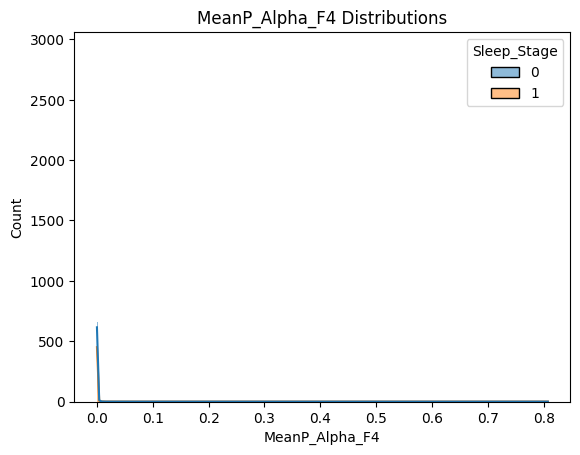

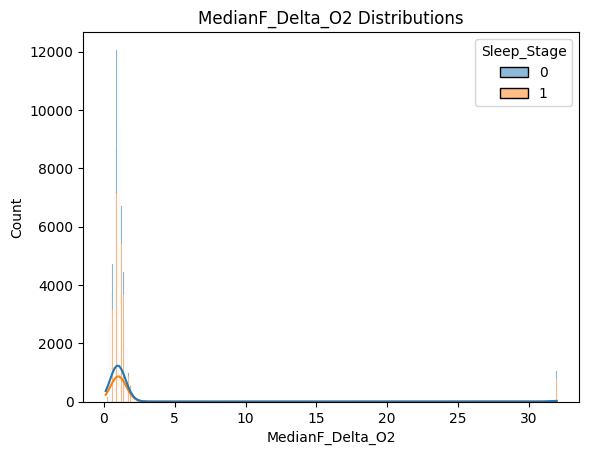

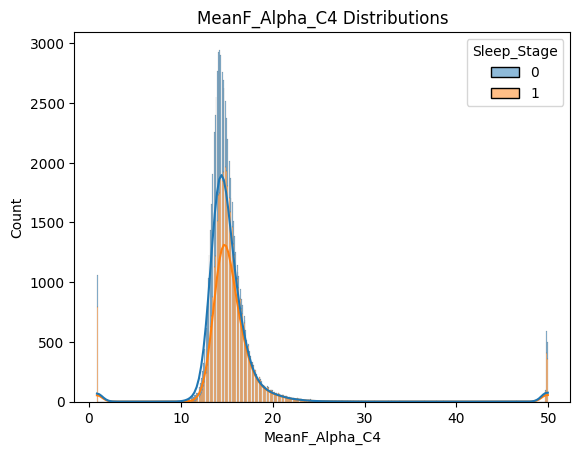

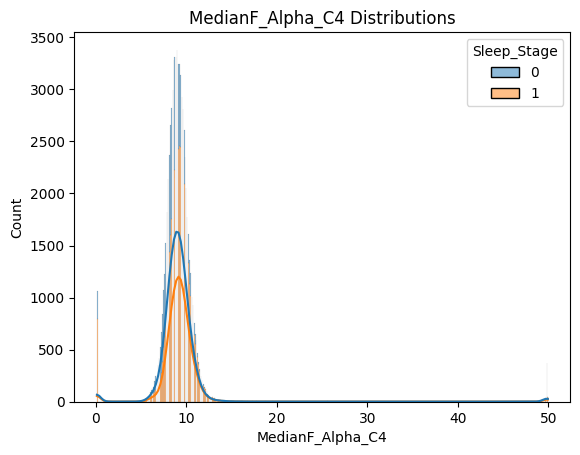

In [ ]:
numeric_col = PEARSON_feature[0:9]

for i in numeric_col[0:9]:
  plt.figure()
  sns.histplot(data=df,x=i, hue="Sleep_Stage",kde = True, multiple="stack")
  plt.title(i+" Distributions")
  plt.show()

# Spliting Dataset into X(features) and y(target)

In [22]:
X = df.loc[:,df.columns != target]
y = df[target]

# Scaling Dataset

In [23]:
X

,MeanF_Alpha_F4,MedianF_Alpha_F4,MeanP_Alpha_O2,MedianF_Delta_C4,MedianF_Delta_F4,MeanP_Alpha_F4,MedianF_Delta_O2,MeanF_Alpha_C4,MedianF_Alpha_C4,MeanF_Beta_F4,...,SpectralEdge_Beta_C4,MeanF_Theta_C4,MedianF_Theta_C4,SpectralEdge_Beta_F4,MeanP_Theta_C4,MeanP_Beta_C4,MeanF_Beta_O2,MeanP_Beta_O2,MeanP_Theta_F4,MeanP_Theta_O2
0,17.85756,10.11512,0.00023,0.87415,0.74927,0.00034,0.74927,18.48195,9.86537,25.35024,...,27.22341,12.11317,5.86927,27.47317,0.00048,0.00054,25.84976,0.00034,0.00041,0.00025
1,17.60780,10.73951,0.00023,0.87415,0.74927,0.00035,0.99902,19.60585,10.48976,25.22537,...,27.09854,12.98732,5.61951,26.97366,0.00051,0.00064,26.22439,0.00032,0.00040,0.00027
2,17.60780,9.36585,0.00025,1.62341,0.99902,0.00035,1.49854,17.35805,8.99122,26.09951,...,27.97268,10.61463,5.12000,28.47220,0.00078,0.00047,26.47415,0.00031,0.00052,0.00036
3,15.98439,9.74049,0.00029,0.87415,0.74927,0.00054,0.87415,17.10829,10.24000,21.72878,...,23.10244,12.98732,6.49366,22.47805,0.00059,0.00064,22.72780,0.00030,0.00058,0.00033
4,16.48390,10.11512,0.00020,0.74927,0.62439,0.00034,0.87415,17.10829,9.86537,22.10341,...,23.85171,12.36293,6.24390,23.47707,0.00042,0.00040,22.97756,0.00023,0.00044,0.00021
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
72626,15.23512,9.49073,0.00027,0.99902,0.99902,0.00027,0.99902,14.73561,9.61561,22.60293,...,22.60293,11.11415,4.24585,23.72683,0.00059,0.00022,22.60293,0.00021,0.00061,0.00061
72627,15.60976,9.61561,0.00024,0.99902,0.74927,0.00024,0.74927,15.23512,8.61659,22.85268,...,22.85268,10.48976,3.87122,23.85171,0.00068,0.00019,22.85268,0.00020,0.00056,0.00056
72628,15.36000,10.24000,0.00026,0.87415,0.74927,0.00026,0.74927,15.23512,10.24000,22.72780,...,22.97756,11.48878,4.62049,23.60195,0.00046,0.00021,22.72780,0.00022,0.00051,0.00051
72629,15.36000,8.61659,0.00026,0.99902,0.87415,0.00026,0.87415,15.36000,8.36683,22.97756,...,23.85171,10.86439,4.12098,24.10146,0.00058,0.00018,22.97756,0.00020,0.00056,0.00056


In [24]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
scaler.fit(X)
X[X.columns] =   scaler.transform(X)

C:\Users\RAZER\AppData\Local\Temp\ipykernel_17548\1173521415.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X[X.columns] =   scaler.transform(X)


In [25]:
X

,MeanF_Alpha_F4,MedianF_Alpha_F4,MeanP_Alpha_O2,MedianF_Delta_C4,MedianF_Delta_F4,MeanP_Alpha_F4,MedianF_Delta_O2,MeanF_Alpha_C4,MedianF_Alpha_C4,MeanF_Beta_F4,...,SpectralEdge_Beta_C4,MeanF_Theta_C4,MedianF_Theta_C4,SpectralEdge_Beta_F4,MeanP_Theta_C4,MeanP_Beta_C4,MeanF_Beta_O2,MeanP_Beta_O2,MeanP_Theta_F4,MeanP_Theta_O2
0,0.735686,0.594647,-0.092332,-0.193415,-0.202155,-0.100254,-0.188472,0.611298,0.184280,-0.093541,...,-0.095448,-0.006670,-0.033532,-0.061905,-0.105332,-0.056032,-0.197575,-0.114450,-0.103471,-0.094887
1,0.673299,0.923647,-0.092332,-0.193415,-0.202155,-0.098638,-0.121487,0.833272,0.359354,-0.102278,...,-0.103624,0.115704,-0.068306,-0.095811,-0.103635,-0.054177,-0.172374,-0.117896,-0.104190,-0.093445
2,0.673299,0.199846,-0.089133,0.008245,-0.135040,-0.098638,0.012486,0.389324,-0.060823,-0.041116,...,-0.046389,-0.216452,-0.137854,0.005908,-0.088362,-0.057330,-0.155573,-0.119618,-0.095564,-0.086955
3,0.267796,0.397249,-0.082734,-0.193415,-0.202155,-0.067944,-0.154978,0.339996,0.289323,-0.346928,...,-0.365270,0.115704,0.053404,-0.400966,-0.099110,-0.054177,-0.407582,-0.121341,-0.091251,-0.089118
4,0.392566,0.594647,-0.097131,-0.227026,-0.235713,-0.100254,-0.154978,0.339996,0.184280,-0.320715,...,-0.316212,0.028295,0.018629,-0.333154,-0.108726,-0.058629,-0.390781,-0.133400,-0.101315,-0.097771
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
72626,0.080640,0.265647,-0.085933,-0.159807,-0.135040,-0.111562,-0.121487,-0.128617,0.114250,-0.285765,...,-0.397976,-0.146524,-0.259564,-0.316201,-0.099110,-0.061968,-0.415981,-0.136845,-0.089094,-0.068928
72627,0.174219,0.331448,-0.090732,-0.159807,-0.202155,-0.116409,-0.188472,-0.029962,-0.165866,-0.268290,...,-0.381624,-0.233933,-0.311725,-0.307724,-0.094018,-0.062524,-0.399181,-0.138568,-0.092689,-0.072533
72628,0.111833,0.660448,-0.087533,-0.193415,-0.202155,-0.113178,-0.188472,-0.029962,0.289323,-0.277028,...,-0.373447,-0.094079,-0.207402,-0.324677,-0.106463,-0.062153,-0.407582,-0.135122,-0.096283,-0.076139
72629,0.111833,-0.194949,-0.087533,-0.159807,-0.168596,-0.113178,-0.154978,-0.005297,-0.235897,-0.259553,...,-0.316212,-0.181488,-0.276950,-0.290771,-0.099675,-0.062710,-0.390781,-0.138568,-0.092689,-0.072533


# Spliting X and y to train and test sets

In [26]:
from sklearn.model_selection import train_test_split
X_train, X_test_val, y_train, y_test_val= train_test_split(X,y, test_size=0.3,random_state=42)

#we divided 70:30 = train:test_val. Now we have 70% data in our test set. Then we devided 30% into half. So we have 15% of total data in trest and validation.
X_test, X_val, y_test, y_val= train_test_split(X_test_val, y_test_val, train_size=.5, random_state=42)

In [27]:
X_train.shape[0],X_val.shape[0],X_test.shape[0]

(50841, 10895, 10895)

In [28]:
X_train

,MeanF_Alpha_F4,MedianF_Alpha_F4,MeanP_Alpha_O2,MedianF_Delta_C4,MedianF_Delta_F4,MeanP_Alpha_F4,MedianF_Delta_O2,MeanF_Alpha_C4,MedianF_Alpha_C4,MeanF_Beta_F4,...,SpectralEdge_Beta_C4,MeanF_Theta_C4,MedianF_Theta_C4,SpectralEdge_Beta_F4,MeanP_Theta_C4,MeanP_Beta_C4,MeanF_Beta_O2,MeanP_Beta_O2,MeanP_Theta_F4,MeanP_Theta_O2
27540,-3.506514,-4.669346,-0.129127,8.175585,8.187371,-0.155181,8.184753,-2.866300,-2.546865,7.079937,...,6.494780,7.248294,8.051445,6.753226,-0.132485,-0.066049,6.665438,-0.173021,-0.132944,-0.112914
68165,-0.262480,-0.392352,-0.044339,-0.227026,-0.202155,0.061295,-0.188472,-0.177945,-0.165866,0.098684,...,0.362435,-0.268897,-0.276950,1.446917,0.063240,-0.046757,1.415275,-0.083442,0.084149,-0.015567
52225,-0.387250,-0.260750,-0.033141,-0.193415,-0.135040,-0.051789,-0.121487,-0.325926,-0.200881,-0.390615,...,-0.545153,-0.233933,-0.190015,-0.485731,-0.046501,-0.058258,0.323242,-0.104114,-0.019366,-0.016289
71448,-0.480827,-0.326551,-0.074735,-0.193415,-0.168596,-0.082483,-0.221965,-0.276600,-0.410970,-0.477990,...,-0.610564,-0.303861,-0.329112,-0.578973,-0.057815,-0.061968,-0.399181,-0.145458,-0.038775,-0.035037
62702,-0.418443,-1.050351,-0.065136,-0.227026,-0.168596,-0.076021,-0.154978,-0.128617,-0.340939,-0.364403,...,-0.626917,-0.303861,-0.294337,-0.468779,-0.049330,-0.060298,1.415275,-0.129954,-0.018647,-0.028547
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
37194,-0.200094,-0.458153,-0.055537,-0.126196,-0.135040,-0.006555,-0.087994,-0.177945,-0.375955,-0.504202,...,-0.569682,-0.233933,-0.172629,-0.578973,-0.006338,-0.053064,-0.474784,-0.117896,-0.006427,-0.051622
6265,0.610916,-0.194949,-0.007544,-0.327859,-0.302831,-0.037250,-0.288952,0.463315,-0.200881,0.177321,...,0.158023,-0.146524,-0.311725,0.226297,-0.029531,-0.050467,0.071233,-0.002477,-0.011459,0.023371
54886,-0.012937,-0.392352,-0.060337,-0.126196,-0.101482,-0.058251,-0.154978,0.019367,-0.340939,-0.294503,...,-0.324388,-0.233933,-0.276950,-0.350107,-0.065735,-0.059927,-0.365580,-0.133400,-0.025117,-0.027826
860,0.579722,0.134051,-0.052338,-0.092585,-0.202155,-0.118024,-0.054500,0.685291,-0.025808,0.098684,...,1.392668,-0.094079,-0.137854,1.455394,-0.099110,-0.052693,-0.432782,-0.111005,-0.105628,-0.048737


# Oversampling using SMOTE
SNB: We used SMOTE in train data only, so that our test data can remain corrupted data free. The accurecy of the model will be counted only for actual data.

In [29]:
!pip install imbalanced-learn

<AxesSubplot: xlabel='Sleep_Stage', ylabel='count'>

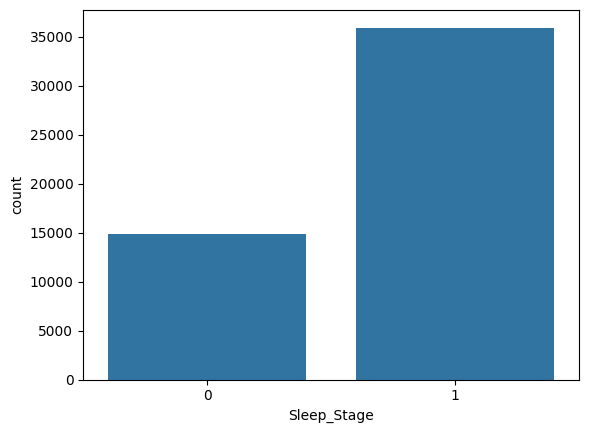

In [30]:
import matplotlib.pyplot as plt
import seaborn as sns

sns.countplot(x=y_train)

In [31]:
from imblearn.over_sampling import SMOTE

smote = SMOTE()
X_train,y_train = smote.fit_resample(X_train,y_train)

<AxesSubplot: xlabel='Sleep_Stage', ylabel='count'>

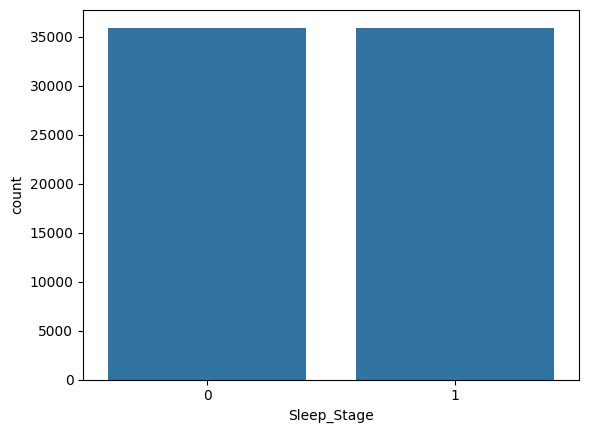

In [32]:
import matplotlib.pyplot as plt
import seaborn as sns

sns.countplot(x=y_train)

# Model Selection & Training

# ADABOOST

## For Deafult Hyparameters

In [33]:
from sklearn.ensemble import AdaBoostClassifier

ada_defult = AdaBoostClassifier()
ada_defult.fit(X_train, y_train)
y_pred_val = ada_defult.predict(X_val)


print("Accuracy: ",accuracy_score(y_val, y_pred_val))

Accurecy:  0.8359798072510326


## Tunning n_estimators(done)

  0%|          | 0/50 [00:00<?, ?it/s]

1/250 round completed......................... Val Accuracy: 0.7146397430013768 >>>>>>Train Accuracy: 0.7444283687153946
6/250 round completed......................... Val Accuracy: 0.773841211564938 >>>>>>Train Accuracy: 0.8020088478339501
11/250 round completed......................... Val Accuracy: 0.7960532354290959 >>>>>>Train Accuracy: 0.8175760273782031
16/250 round completed......................... Val Accuracy: 0.8071592473611748 >>>>>>Train Accuracy: 0.8272863860215353
21/250 round completed......................... Val Accuracy: 0.8146856356126664 >>>>>>Train Accuracy: 0.8281767340919841
26/250 round completed......................... Val Accuracy: 0.8220284534189995 >>>>>>Train Accuracy: 0.8350212848835592
31/250 round completed......................... Val Accuracy: 0.8257916475447453 >>>>>>Train Accuracy: 0.8421579811357502
36/250 round completed......................... Val Accuracy: 0.8271684258834328 >>>>>>Train Accuracy: 0.8441334409170586
41/250 round completed.....

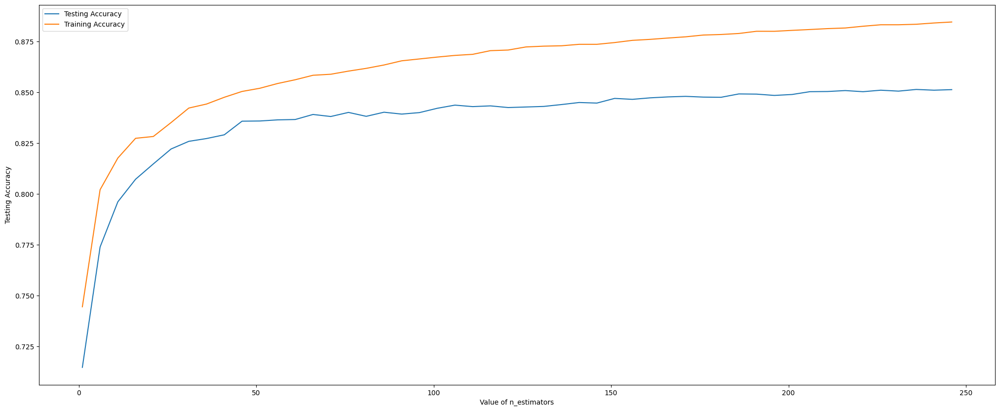

In [34]:
from sklearn.ensemble import AdaBoostClassifier
N=250
k_range = range (1,N+1,5)
scores={}
scores_list = []
score_list_train = []
for k in tqdm(k_range):
  classifier = AdaBoostClassifier(n_estimators=k,random_state=0)
  classifier.fit(X_train, y_train)

  y_pred=classifier.predict(X_val)
  val_accu = accuracy_score(y_val,y_pred)
  scores[k] = val_accu
  scores_list.append(val_accu)

  y_pred=classifier.predict(X_train)
  train_accu = accuracy_score(y_train,y_pred)
  score_list_train.append(train_accu)

  print(str(k)+"/"+str(N)+" round completed......................... Val Accuracy: "+str(val_accu),">>>>>>Train Accuracy: "+str(train_accu))



%matplotlib inline
import matplotlib.pyplot as plt
#plot the relationship between K and the testing accuracy
plt.figure(figsize = (25,10))
plt.plot(k_range,scores_list)
plt.plot(k_range,score_list_train)
plt.xlabel('Value of n_estimators')
plt.ylabel ('Testing Accuracy')
plt.legend(["Testing Accuracy", "Training Accuracy"], loc=0, frameon=True)



print("The best n_estimators:")
best_estimator=list(scores.keys())[scores_list.index(max(scores_list))]
print(best_estimator)

In [ ]:
from sklearn.ensemble import AdaBoostClassifier

ada_best_estimator = AdaBoostClassifier(n_estimators=best_estimator,random_state=0)
ada_best_estimator.fit(X_train, y_train)
y_pred = ada_best_estimator.predict(X_test)

from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
print(classification_report(y_test,y_pred))
print("Accuracy: ",accuracy_score(y_test, y_pred))

# Graddient Boosting

## Deafult Hyperparameters

In [36]:
from sklearn.ensemble import GradientBoostingClassifier

gradBoost_default = GradientBoostingClassifier()
gradBoost_default.fit(X_train, y_train)
y_pred_val = gradBoost_default.predict(X_val)

from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
print(confusion_matrix(y_val, y_pred_val))
print(classification_report(y_val,y_pred_val))
print("Accuracy: ",accuracy_score(y_val, y_pred_val))

[[2633  612]
 [ 949 6701]]
              precision    recall  f1-score   support

           0       0.74      0.81      0.77      3245
           1       0.92      0.88      0.90      7650

    accuracy                           0.86     10895
   macro avg       0.83      0.84      0.83     10895
weighted avg       0.86      0.86      0.86     10895

Accurecy:  0.8567232675539238


## Tunning n_estimators

  0%|          | 0/17 [00:00<?, ?it/s]

370/450 round completed.........................Val Accurecy: 0.8797613584212942  >>>Train Accuracy: 0.9165298683954258
375/450 round completed.........................Val Accurecy: 0.879669573198715  >>>Train Accuracy: 0.9169472190534487
380/450 round completed.........................Val Accurecy: 0.88022028453419  >>>Train Accuracy: 0.9171837177596617
385/450 round completed.........................Val Accurecy: 0.8804956402019275  >>>Train Accuracy: 0.9174480398430761
390/450 round completed.........................Val Accurecy: 0.8800367140890316  >>>Train Accuracy: 0.9175175982860799
395/450 round completed.........................Val Accurecy: 0.8799449288664525  >>>Train Accuracy: 0.9177958320580952
400/450 round completed.........................Val Accurecy: 0.8800367140890316  >>>Train Accuracy: 0.9181158008959127
405/450 round completed.........................Val Accurecy: 0.8800367140890316  >>>Train Accuracy: 0.9185053281767341
410/450 round completed....................

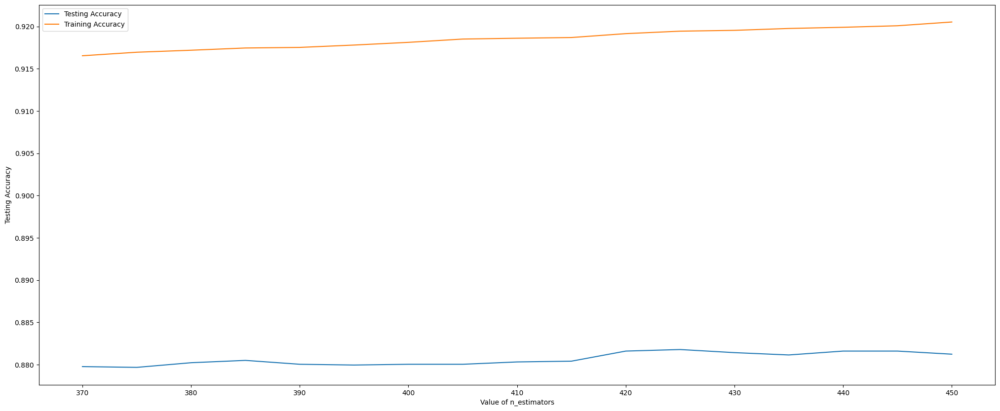

In [37]:
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.metrics import accuracy_score
N=450
k_range = range (370,N+1,5)
scores={}
scores_list = []
scores_list_train = []
for k in tqdm(k_range):
  classifier = GradientBoostingClassifier(n_estimators=k,random_state=0)
  classifier.fit(X_train, y_train)
  y_pred=classifier.predict(X_val)
  val_accu =  accuracy_score(y_val,y_pred)
  scores[k] =val_accu
  scores_list.append(val_accu)

  y_pred=classifier.predict(X_train)
  train_accu = accuracy_score(y_train,y_pred)
  scores_list_train.append(train_accu)


  print(str(k)+"/"+str(N)+" round completed.........................Val Accuracy: "+str(val_accu)," >>>Train Accuracy: "+str(train_accu))



%matplotlib inline
import matplotlib.pyplot as plt

plt.figure(figsize = (25,10))
plt.plot(k_range,scores_list)
plt.plot(k_range,scores_list_train)
plt.xlabel('Value of n_estimators')
plt.ylabel ('Testing Accuracy')
plt.legend(["Testing Accuracy", "Training Accuracy"], loc=0, frameon=True)



print("The best n_estimators:")
best_estimator=list(scores.keys())[scores_list.index(max(scores_list))]
print(best_estimator)

## Tunning max_depth (done)

  0%|          | 0/6 [00:00<?, ?it/s]

1/30 round completed.........................Val Accuracy: 0.8222120238641579  Training Accuracy0.835090843326563
6/30 round completed.........................Val Accuracy: 0.8826984855438275  Training Accuracy0.9285913024122868
11/30 round completed.........................Val Accuracy: 0.9005966039467646  Training Accuracy0.9924320414011852
16/30 round completed.........................Val Accuracy: 0.8987608994951812  Training Accuracy0.9940736206560752
21/30 round completed.........................Val Accuracy: 0.8850849013308857  Training Accuracy0.9940736206560752
26/30 round completed.........................Val Accuracy: 0.840110142267095  Training Accuracy0.9940736206560752
The best Depth:
11


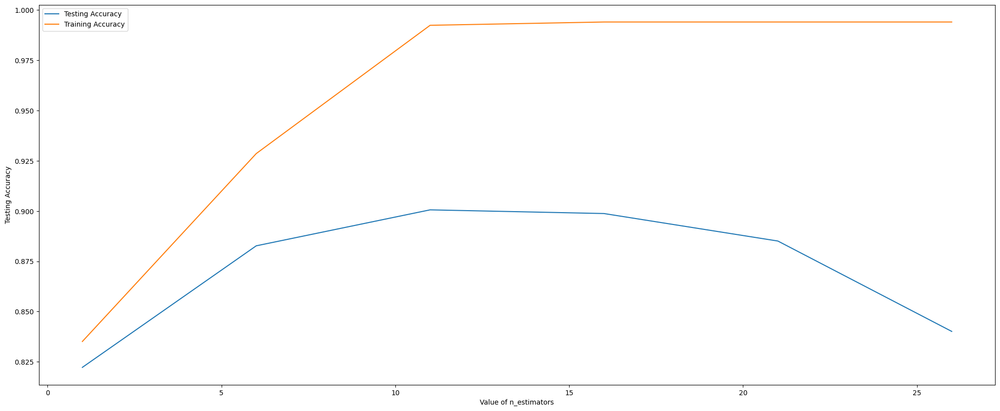

In [38]:
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.metrics import accuracy_score
N=30
k_range = range (1,N+1,5)
scores={}
scores_list = []
scores_list_train = []
for k in tqdm(k_range):
  classifier = GradientBoostingClassifier(max_depth=k,random_state=0)
  classifier.fit(X_train, y_train)

  y_pred=classifier.predict(X_val)
  val_accu = accuracy_score(y_val,y_pred)
  scores[k] = val_accu
  scores_list.append(val_accu)

  y_pred=classifier.predict(X_train)
  train_accu =  accuracy_score(y_train,y_pred)
  scores_list_train.append(train_accu)

  print(str(k)+"/"+str(N)+" round completed.........................Val Accuracy: "+str(val_accu)," Training Accuracy"+str(train_accu))



%matplotlib inline
import matplotlib.pyplot as plt

plt.figure(figsize = (25,10))
plt.plot(k_range,scores_list)
plt.plot(k_range,scores_list_train)
plt.xlabel('Value of n_estimators')
plt.ylabel ('Testing Accuracy')
plt.legend(["Testing Accuracy", "Training Accuracy"], loc=0, frameon=True)



print("The best Depth:")
best_depth=list(scores.keys())[scores_list.index(max(scores_list))]
print(best_depth)

In [39]:
gradBoost_estimator = GradientBoostingClassifier(n_estimators=best_estimator,random_state=0)
gradBoost_estimator.fit(X_train, y_train)
y_pred = gradBoost_estimator.predict(X_test)
print("Accuracy: ",accuracy_score(y_test, y_pred))

Accurecy:  0.8861863240018357


In [40]:
gradBoost_depth = GradientBoostingClassifier(max_depth=best_depth,random_state=0)
gradBoost_depth.fit(X_train, y_train)
y_pred = gradBoost_depth.predict(X_test)
print("Accuracy: ",accuracy_score(y_test, y_pred))

Accurecy:  0.9033501606241395


In [52]:
from sklearn.ensemble import GradientBoostingClassifier
gradBoost_all = GradientBoostingClassifier(n_estimators=best_estimator,max_depth=best_depth,random_state=0)
gradBoost_all.fit(X_train, y_train)
y_pred = gradBoost_all.predict(X_test)
print("Accuracy: ",accuracy_score(y_test, y_pred))

Accuracy:  0.9083065626434144


# XGB

## Deafult Hyperparameters

In [42]:
import xgboost as xgb
xgb_deafult = xgb.XGBClassifier()
xgb_deafult.fit(X_train.values,y_train.values)
y_pred_val = xgb_deafult.predict(X_val.values)

from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
print(confusion_matrix(y_val, y_pred_val))
print(classification_report(y_val,y_pred_val))
print("Accuracy: ",accuracy_score(y_val, y_pred_val))

[[2614  631]
 [ 512 7138]]
              precision    recall  f1-score   support

           0       0.84      0.81      0.82      3245
           1       0.92      0.93      0.93      7650

    accuracy                           0.90     10895
   macro avg       0.88      0.87      0.87     10895
weighted avg       0.89      0.90      0.89     10895

Accurecy:  0.8950894905920147


## Tunning n_estimators (done)

  0%|          | 0/30 [00:00<?, ?it/s]

1/150 round completed......................... Val Accureay: 0.812299219825608  >>>>>>Training Accuracy: 0.837845357669514
6/150 round completed......................... Val Accureay: 0.8458926112895824  >>>>>>Training Accuracy: 0.8715812025263626
11/150 round completed......................... Val Accureay: 0.855162918770078  >>>>>>Training Accuracy: 0.8884282574218859
16/150 round completed......................... Val Accureay: 0.8671867829279486  >>>>>>Training Accuracy: 0.9030494421412871
21/150 round completed......................... Val Accureay: 0.8708581918311152  >>>>>>Training Accuracy: 0.9113964553017445
26/150 round completed......................... Val Accureay: 0.8755392381826526  >>>>>>Training Accuracy: 0.9175315099746807
31/150 round completed......................... Val Accureay: 0.8778338687471318  >>>>>>Training Accuracy: 0.9225258061823545
36/150 round completed......................... Val Accureay: 0.8809545663148233  >>>>>>Training Accuracy: 0.92658801925377

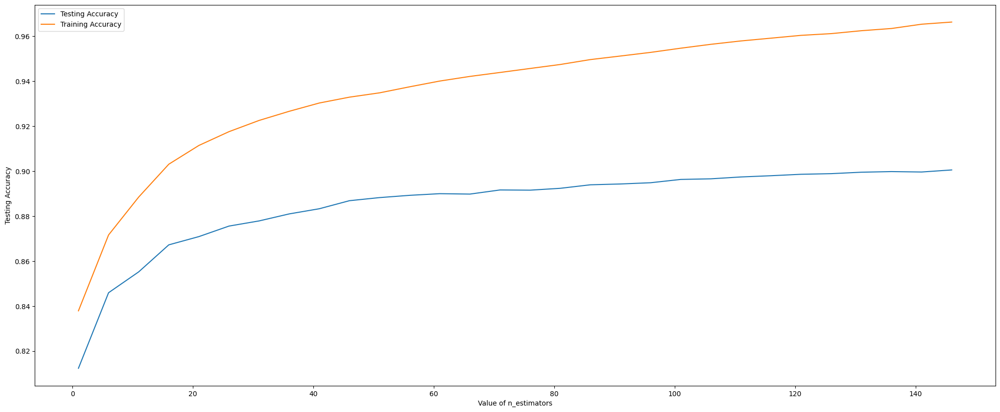

In [43]:
import xgboost as xgb
from sklearn.metrics import accuracy_score
N=150
k_range = range (1,N+1,5)
scores={}
scores_list = []
scores_list_train = []
for k in tqdm(k_range):
  xgb_classifier = xgb.XGBClassifier(n_estimators=k,random_state=0)
  xgb_classifier.fit(X_train.values, y_train.values)

  y_pred=xgb_classifier.predict(X_val.values)
  val_accu = accuracy_score(y_val,y_pred)
  scores[k] = val_accu
  scores_list.append(val_accu)

  y_pred=xgb_classifier.predict(X_train.values)
  train_accu = accuracy_score(y_train,y_pred)
  scores_list_train.append(train_accu)


  print(str(k)+"/"+str(N)+" round completed......................... Val Accureay: "+str(val_accu)," >>>>>>Training Accuracy: "+str(train_accu))


%matplotlib inline
import matplotlib.pyplot as plt

plt.figure(figsize = (25,10))
plt.plot(k_range,scores_list)
plt.plot(k_range,scores_list_train)
plt.xlabel('Value of n_estimators')
plt.ylabel ('Testing Accuracy')
plt.legend(["Testing Accuracy", "Training Accuracy"], loc=0, frameon=True)


print("The best n_estimators:")
best_estimator=list(scores.keys())[scores_list.index(max(scores_list))]
print(best_estimator)

## Tunning max_depth(done)

  0%|          | 0/6 [00:00<?, ?it/s]

1/30 round completed......................... Val Accuracy: 0.8378155117026159  >>>>>>> Train Accuracy: 0.849670292980162
6/30 round completed......................... Val Accuracy: 0.8950894905920147  >>>>>>> Train Accuracy: 0.9537992821568682
11/30 round completed......................... Val Accuracy: 0.9071133547498853  >>>>>>> Train Accuracy: 0.9940736206560752
16/30 round completed......................... Val Accuracy: 0.9095915557595227  >>>>>>> Train Accuracy: 0.9940736206560752
21/30 round completed......................... Val Accuracy: 0.9065626434144103  >>>>>>> Train Accuracy: 0.9940736206560752
26/30 round completed......................... Val Accuracy: 0.9064708581918312  >>>>>>> Train Accuracy: 0.9940736206560752
The best depth:
16


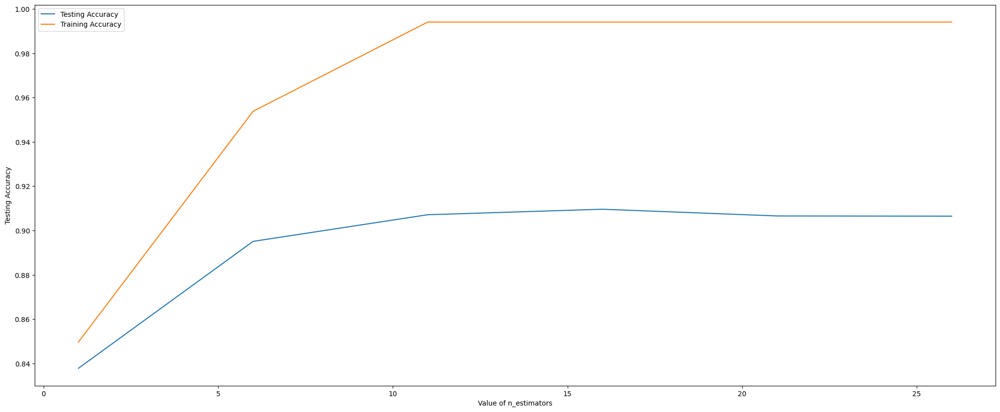

In [58]:
import xgboost as xgb
from sklearn.metrics import accuracy_score
N=30
k_range = range (1,N+1,5)
scores={}
scores_list = []
scores_list_train = []
for k in tqdm(k_range):
  xgb_classifier = xgb.XGBClassifier(max_depth=k,random_state=0)
  xgb_classifier.fit(X_train.values, y_train.values)

  y_pred=xgb_classifier.predict(X_val.values)
  val_accu = accuracy_score(y_val,y_pred)
  scores[k] = val_accu
  scores_list.append(val_accu)

  y_pred=xgb_classifier.predict(X_train.values)
  train_accu = accuracy_score(y_train,y_pred)
  scores_list_train.append(train_accu)


  print(str(k)+"/"+str(N)+" round completed......................... Val Accuracy: "+str(val_accu)," >>>>>>> Train Accuracy: "+str(train_accu))


%matplotlib inline
import matplotlib.pyplot as plt

plt.figure(figsize = (25,10))
plt.plot(k_range,scores_list)
plt.plot(k_range,scores_list_train)
plt.xlabel('Value of n_estimators')
plt.ylabel ('Testing Accuracy')
plt.legend(["Testing Accuracy", "Training Accuracy"], loc=0, frameon=True)


print("The best depth:")
best_depth=list(scores.keys())[scores_list.index(max(scores_list))]
print(best_depth)

In [ ]:
import xgboost as xgb
xgb_depth = xgb.XGBClassifier(max_depth=best_depth,random_state=0)
xgb_depth.fit(X_train.values,y_train.values)
y_pred = xgb_depth.predict(X_test.values)
print("Accuracy: ",accuracy_score(y_test, y_pred))

Accurecy:  0.9081229921982561


In [51]:
import xgboost as xgb
xgb_estimator = xgb.XGBClassifier(n_estimators=best_estimator,random_state=0)
xgb_estimator.fit(X_train.values,y_train.values)
y_pred = xgb_estimator.predict(X_test.values)
print("Accuracy: ",accuracy_score(y_test, y_pred))

Accuracy:  0.9126204681046352


In [47]:
xgb_all = xgb.XGBClassifier(n_estimators=best_estimator,max_depth=best_depth,random_state=0)
xgb_all.fit(X_train.values,y_train.values)
y_pred = xgb_all.predict(X_test.values)

print("Accuracy: ",accuracy_score(y_test, y_pred))

Accurecy:  0.9093162000917853


# RandomForestClassifier

## Deafult Hyperparameters

In [48]:
from sklearn.ensemble import RandomForestClassifier
rf_default = RandomForestClassifier()
rf_default.fit(X_train, y_train)
y_pred_val=rf_default.predict(X_val)


from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
print(confusion_matrix(y_val, y_pred_val))
print(classification_report(y_val,y_pred_val))
print("Accuracy: ",accuracy_score(y_val, y_pred_val))

[[2711  534]
 [ 564 7086]]
              precision    recall  f1-score   support

           0       0.83      0.84      0.83      3245
           1       0.93      0.93      0.93      7650

    accuracy                           0.90     10895
   macro avg       0.88      0.88      0.88     10895
weighted avg       0.90      0.90      0.90     10895

Accurecy:  0.8992198256080771


## Tunning n_estimators (done)

196/250 round completed......................... Val Accuracy: 0.8986691142726021  >>>>>>> Train Accuracy: 0.9940736206560752
201/250 round completed......................... Val Accuracy: 0.8988526847177605  >>>>>>> Train Accuracy: 0.9940736206560752
206/250 round completed......................... Val Accuracy: 0.8989444699403396  >>>>>>> Train Accuracy: 0.9940736206560752
211/250 round completed......................... Val Accuracy: 0.8989444699403396  >>>>>>> Train Accuracy: 0.9940736206560752
216/250 round completed......................... Val Accuracy: 0.8986691142726021  >>>>>>> Train Accuracy: 0.9940736206560752
221/250 round completed......................... Val Accuracy: 0.898577329050023  >>>>>>> Train Accuracy: 0.9940736206560752
226/250 round completed......................... Val Accuracy: 0.8983937586048646  >>>>>>> Train Accuracy: 0.9940736206560752
231/250 round completed......................... Val Accuracy: 0.8983937586048646  >>>>>>> Train Accuracy: 0.9940736206

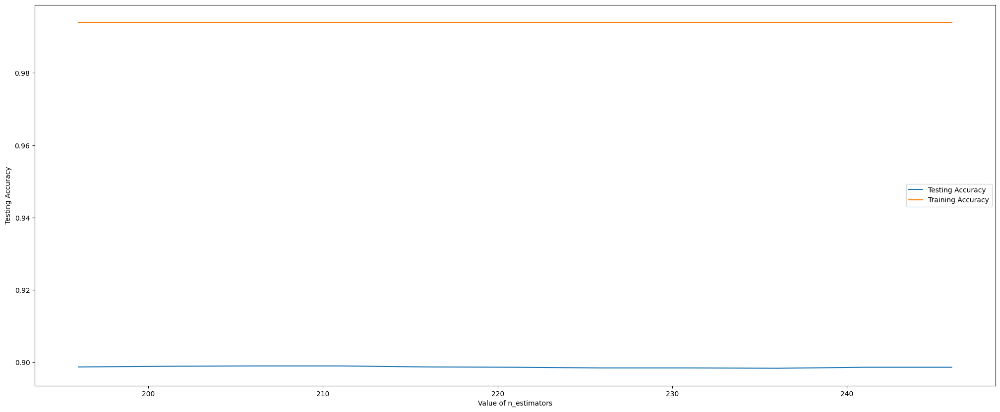

In [59]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
N=250
k_range = range (196,N+1,5)
scores={}
scores_list = []
scores_list_train = []
for k in k_range:
  classifier = RandomForestClassifier(n_estimators=k,random_state=0)
  classifier.fit(X_train, y_train)


  y_pred=classifier.predict(X_val)
  val_accu = accuracy_score(y_val,y_pred)
  scores[k] = val_accu
  scores_list.append(val_accu)

  y_pred=classifier.predict(X_train)
  train_accu = accuracy_score(y_train,y_pred)
  scores_list_train.append(train_accu)

  print(str(k)+"/"+str(N)+" round completed......................... Val Accuracy: "+str(val_accu)," >>>>>>> Train Accuracy: "+str(train_accu))



%matplotlib inline
import matplotlib.pyplot as plt

plt.figure(figsize = (25,10))
plt.plot(k_range,scores_list)
plt.plot(k_range,scores_list_train)
plt.xlabel('Value of n_estimators')
plt.ylabel ('Testing Accuracy')
plt.legend(["Testing Accuracy", "Training Accuracy"], loc=0, frameon=True)


print("The best n_estimators:")
best_estimator=list(scores.keys())[scores_list.index(max(scores_list))]
print(best_estimator)

## Tunning max_depth(done)

1/50 round completed......................... Val Accuracy: 0.7608077099586966  >>>>>>> Train Accuracy: 0.7809465512923959
6/50 round completed......................... Val Accuracy: 0.8396512161541991  >>>>>>> Train Accuracy: 0.8566122255919424
11/50 round completed......................... Val Accuracy: 0.872418540614961  >>>>>>> Train Accuracy: 0.9252664088367046
16/50 round completed......................... Val Accuracy: 0.8899495181275815  >>>>>>> Train Accuracy: 0.9781864722740046
21/50 round completed......................... Val Accuracy: 0.8953648462597522  >>>>>>> Train Accuracy: 0.9904148465540747
26/50 round completed......................... Val Accuracy: 0.8984855438274438  >>>>>>> Train Accuracy: 0.9937675635068585
31/50 round completed......................... Val Accuracy: 0.8983019733822855  >>>>>>> Train Accuracy: 0.9940736206560752
36/50 round completed......................... Val Accuracy: 0.8972923359339147  >>>>>>> Train Accuracy: 0.9940736206560752
41/50 round

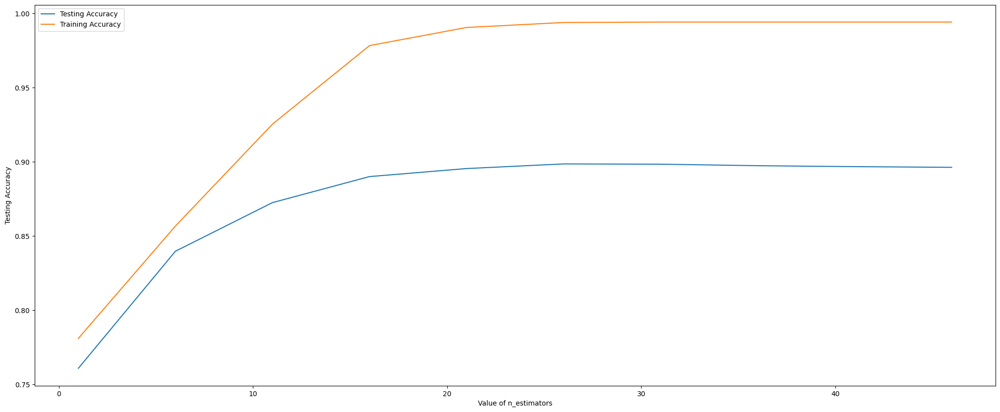

In [60]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
N=50
k_range = range (1,N+1,5)
scores={}
scores_list = []
scores_list_train = []
for k in k_range:
  classifier = RandomForestClassifier(max_depth=k,random_state=0)
  classifier.fit(X_train, y_train)

  y_pred=classifier.predict(X_val)
  val_accu = accuracy_score(y_val,y_pred)
  scores[k] = val_accu
  scores_list.append(val_accu)

  y_pred=classifier.predict(X_train)
  train_accu = accuracy_score(y_train,y_pred)
  scores_list_train.append(train_accu)


  print(str(k)+"/"+str(N)+" round completed......................... Val Accuracy: "+str(val_accu)," >>>>>>> Train Accuracy: "+str(train_accu))



%matplotlib inline
import matplotlib.pyplot as plt

plt.figure(figsize = (25,10))
plt.plot(k_range,scores_list)
plt.plot(k_range,scores_list_train)
plt.xlabel('Value of n_estimators')
plt.ylabel ('Testing Accuracy')
plt.legend(["Testing Accuracy", "Training Accuracy"], loc=0, frameon=True)


print("The best Depth:")
best_depth=list(scores.keys())[scores_list.index(max(scores_list))]
print(best_depth)

In [51]:
rf_estimator = RandomForestClassifier(n_estimators=best_estimator,random_state=0)
rf_estimator.fit(X_train, y_train)
y_pred=rf_estimator.predict(X_test)
print("Accuracy: ",accuracy_score(y_test, y_pred))

Accurecy:  0.9019733822854521


In [52]:
rf_depth = RandomForestClassifier(max_depth=best_depth,random_state=0)
rf_depth.fit(X_train, y_train)
y_pred=rf_depth.predict(X_test)
print("Accuracy: ",accuracy_score(y_test, y_pred))

Accurecy:  0.8998623221661313


In [ ]:
from sklearn.ensemble import RandomForestClassifier
rf_all = RandomForestClassifier(n_estimators=best_estimator,max_depth=best_depth,random_state=0)
rf_all.fit(X_train, y_train)
y_pred=rf_all.predict(X_test)
print("Accuracy: ",accuracy_score(y_test, y_pred))

# KNN

In [54]:
from sklearn.neighbors import KNeighborsClassifier
knn_default = KNeighborsClassifier()
knn_default.fit(X_train, y_train)
y_pred=knn_default.predict(X_test)


from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
print("Accuracy: ",accuracy_score(y_test, y_pred))

Accurecy:  0.8513079394217531


## Tuning n_neighbour

  0%|          | 0/10 [00:00<?, ?it/s]

1/50 round completed......................... Val Accuracy: 0.8684717760440569  >>>>>>> Train Accuracy: 0.9940736206560752
6/50 round completed......................... Val Accuracy: 0.8362551629187701  >>>>>>> Train Accuracy: 0.9080715617261623
11/50 round completed......................... Val Accuracy: 0.8521340064249656  >>>>>>> Train Accuracy: 0.9042041122951504
16/50 round completed......................... Val Accuracy: 0.8364387333639284  >>>>>>> Train Accuracy: 0.8899168081021674
21/50 round completed......................... Val Accuracy: 0.8432308398347866  >>>>>>> Train Accuracy: 0.8883169639130798
26/50 round completed......................... Val Accuracy: 0.8338687471317118  >>>>>>> Train Accuracy: 0.8797751871122117
31/50 round completed......................... Val Accuracy: 0.8385497934832492  >>>>>>> Train Accuracy: 0.8790796026821736
36/50 round completed......................... Val Accuracy: 0.8331344653510785  >>>>>>> Train Accuracy: 0.8724854622854122
41/50 roun

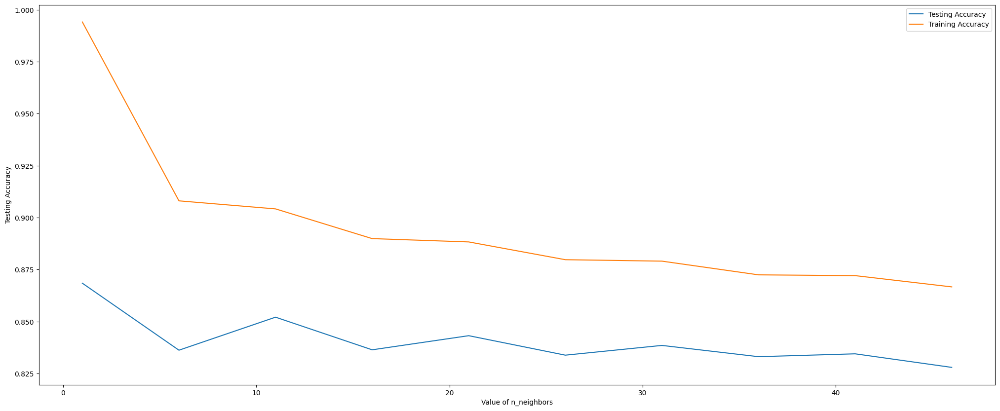

In [61]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score
Neighbors=50
k_range = range (1,Neighbors+1,5)
scores={}
scores_list = []
scores_list_train = []
for k in tqdm(k_range):
  knn = KNeighborsClassifier(n_neighbors=k)
  knn.fit(X_train, y_train)

  y_pred=knn.predict(X_val)
  val_accu = accuracy_score(y_val,y_pred)
  scores[k] = val_accu
  scores_list.append(val_accu)

  y_pred=knn.predict(X_train)
  train_accu = accuracy_score(y_train,y_pred)
  scores_list_train.append(train_accu)


  print(str(k)+"/"+str(N)+" round completed......................... Val Accuracy: "+str(val_accu)," >>>>>>> Train Accuracy: "+str(train_accu))


%matplotlib inline
import matplotlib.pyplot as plt

plt.figure(figsize = (25,10))
plt.plot(k_range,scores_list)
plt.plot(k_range,scores_list_train)
plt.xlabel('Value of n_neighbors')
plt.ylabel ('Testing Accuracy')
plt.legend(["Testing Accuracy", "Training Accuracy"], loc=0, frameon=True)



print("The n_neighbors:")
best=list(scores.keys())[scores_list.index(max(scores_list))]
print(best)

In [ ]:
from sklearn.neighbors import KNeighborsClassifier
knn_neighbors = KNeighborsClassifier(n_neighbors=best)
knn_neighbors.fit(X_train, y_train)
y_pred=knn_neighbors.predict(X_test)


from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
print("Accuracy: ",accuracy_score(y_test, y_pred))

Accurecy:  0.8630564479118862


# Gaussian Naïve Bayes

In [57]:

from sklearn.naive_bayes import GaussianNB

nb_deafult = GaussianNB()
nb_deafult.fit(X_train, y_train)
y_pred = nb_deafult.predict(X_test)


from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
print("Accuracy: ",accuracy_score(y_test, y_pred))

Accurecy:  0.31913721890775587


# HistogramBoosting

## Deafult Param

In [33]:
from sklearn.ensemble import HistGradientBoostingClassifier
his_max_deafult = HistGradientBoostingClassifier(random_state=0)
his_max_deafult.fit(X_train, y_train)
y_pred=his_max_deafult.predict(X_test)
print("Accuracy: ",accuracy_score(y_test, y_pred))

Accurecy:  0.8904084442404773


## Tunning max_iter

240/450 round completed......................... Val Accuracy: 0.8971087654887563  >>>>>>> Train Accuracy: 0.9483598119139701
250/450 round completed......................... Val Accuracy: 0.8974759063790729  >>>>>>> Train Accuracy: 0.9494310119362288
260/450 round completed......................... Val Accuracy: 0.8979348324919688  >>>>>>> Train Accuracy: 0.950474388581286
270/450 round completed......................... Val Accuracy: 0.8983937586048646  >>>>>>> Train Accuracy: 0.9517681756211569
280/450 round completed......................... Val Accuracy: 0.899128040385498  >>>>>>> Train Accuracy: 0.9528532873320164
290/450 round completed......................... Val Accuracy: 0.8999541073887104  >>>>>>> Train Accuracy: 0.9538410172226705
300/450 round completed......................... Val Accuracy: 0.9005048187241854  >>>>>>> Train Accuracy: 0.9546061600957124
310/450 round completed......................... Val Accuracy: 0.8997705369435521  >>>>>>> Train Accuracy: 0.95595559388

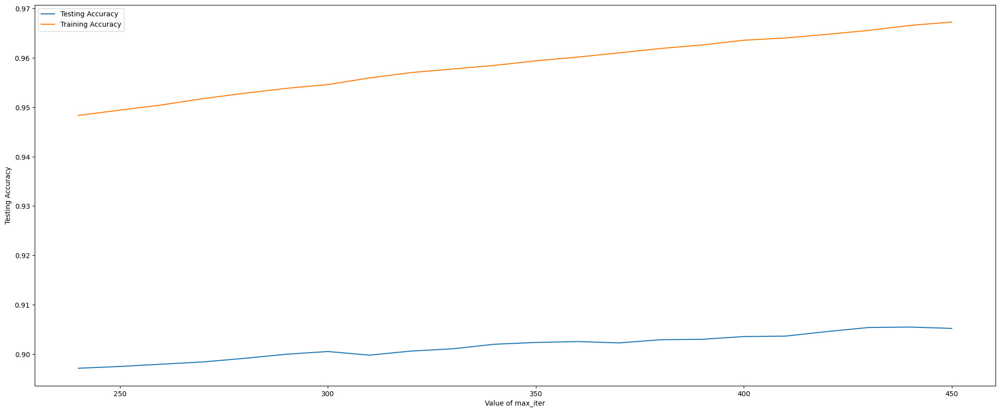

In [43]:
from sklearn.ensemble import HistGradientBoostingClassifier
from sklearn.metrics import accuracy_score
N=450
k_range = range (240,N+1,10)
scores={}
scores_list = []
scores_list_train = []
for k in k_range:
  classifier = HistGradientBoostingClassifier(max_iter=k,random_state=0)
  classifier.fit(X_train, y_train)


  y_pred=classifier.predict(X_val)
  val_accu = accuracy_score(y_val,y_pred)
  scores[k] = val_accu
  scores_list.append(val_accu)

  y_pred=classifier.predict(X_train)
  train_accu = accuracy_score(y_train,y_pred)
  scores_list_train.append(train_accu)

  print(str(k)+"/"+str(N)+" round completed......................... Val Accuracy: "+str(val_accu)," >>>>>>> Train Accuracy: "+str(train_accu))



%matplotlib inline
import matplotlib.pyplot as plt

plt.figure(figsize = (25,10))
plt.plot(k_range,scores_list)
plt.plot(k_range,scores_list_train)
plt.xlabel('Value of max_iter')
plt.ylabel ('Testing Accuracy')
plt.legend(["Testing Accuracy", "Training Accuracy"], loc=0, frameon=True)


print("The best max_iter:")
best_estimator=list(scores.keys())[scores_list.index(max(scores_list))]
print(best_estimator)

## Tunning max_depth

1/60 round completed......................... Val Accuracy: 0.8203763194125746  >>>>>>> Train Accuracy: 0.8315850977991709
6/60 round completed......................... Val Accuracy: 0.8803120697567691  >>>>>>> Train Accuracy: 0.9196043515761944
11/60 round completed......................... Val Accuracy: 0.8867370353373107  >>>>>>> Train Accuracy: 0.9238474165994268
16/60 round completed......................... Val Accuracy: 0.8882973841211564  >>>>>>> Train Accuracy: 0.924890793244484
21/60 round completed......................... Val Accuracy: 0.8871959614502065  >>>>>>> Train Accuracy: 0.9242786789460504
26/60 round completed......................... Val Accuracy: 0.8871959614502065  >>>>>>> Train Accuracy: 0.9242786789460504
31/60 round completed......................... Val Accuracy: 0.8871959614502065  >>>>>>> Train Accuracy: 0.9242786789460504
36/60 round completed......................... Val Accuracy: 0.8871959614502065  >>>>>>> Train Accuracy: 0.9242786789460504
41/60 round

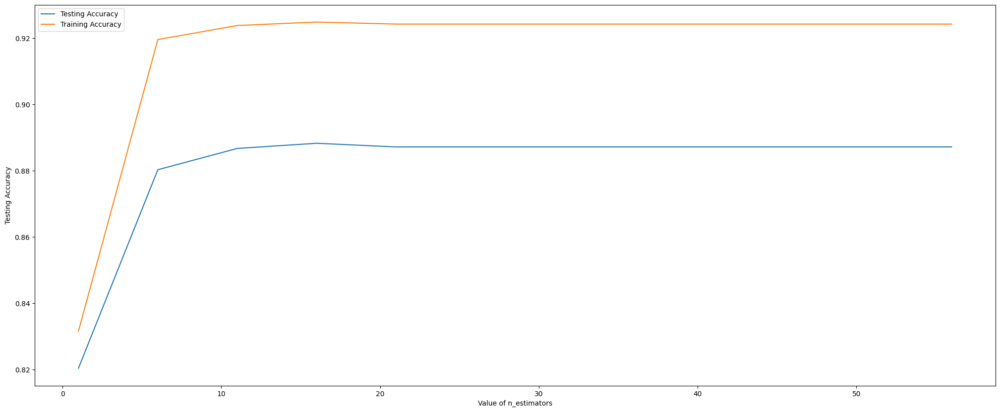

In [44]:
from sklearn.ensemble import HistGradientBoostingClassifier
from sklearn.metrics import accuracy_score
N=60
k_range = range (1,N+1,5)
scores={}
scores_list = []
scores_list_train = []
for k in k_range:
  classifier = HistGradientBoostingClassifier(max_depth=k,random_state=0)
  classifier.fit(X_train, y_train)

  y_pred=classifier.predict(X_val)
  val_accu = accuracy_score(y_val,y_pred)
  scores[k] = val_accu
  scores_list.append(val_accu)

  y_pred=classifier.predict(X_train)
  train_accu = accuracy_score(y_train,y_pred)
  scores_list_train.append(train_accu)


  print(str(k)+"/"+str(N)+" round completed......................... Val Accuracy: "+str(val_accu)," >>>>>>> Train Accuracy: "+str(train_accu))



%matplotlib inline
import matplotlib.pyplot as plt

plt.figure(figsize = (25,10))
plt.plot(k_range,scores_list)
plt.plot(k_range,scores_list_train)
plt.xlabel('Value of n_estimators')
plt.ylabel ('Testing Accuracy')
plt.legend(["Testing Accuracy", "Training Accuracy"], loc=0, frameon=True)


print("The best Depth:")
best_depth=list(scores.keys())[scores_list.index(max(scores_list))]
print(best_depth)

In [45]:
his_max_iter = HistGradientBoostingClassifier(max_iter=best_estimator,random_state=0)
his_max_iter.fit(X_train, y_train)
y_pred=his_max_iter.predict(X_test)
print("Accuracy: ",accuracy_score(y_test, y_pred))

Accuracy:  0.9067462138595687


In [46]:
his_depth = HistGradientBoostingClassifier(max_depth=best_depth,random_state=0)
his_depth.fit(X_train, y_train)
y_pred=his_depth.predict(X_test)
print("Accuracy: ",accuracy_score(y_test, y_pred))

Accuracy:  0.8886645250114732


In [ ]:
from sklearn.ensemble import HistGradientBoostingClassifier
his_all = HistGradientBoostingClassifier(max_iter=best_estimator,max_depth=best_depth,random_state=0)
his_all.fit(X_train, y_train)
y_pred=his_all.predict(X_test)
print("Accuracy: ",accuracy_score(y_test, y_pred))

Accuracy:  0.9081229921982561


# Model Evaluation Matrix 
From the tuning section, we chose only the best models for being evaluated.

## ROC CURVE and Confusion Matrix Function

In [126]:
#ROC Curve Function
from sklearn.metrics import roc_curve, roc_auc_score

graph_attributes={
    "Font Size"  : 15,
    "Font Color" : "black",
    "Legend Font Size"  : 15,
    "Legend Font Color" : "black",
    "Legend bgcolor"    : "LightSteelBlue",
    "Legend bordercolor": "White",
    "Legend borderwidth": 1

}


def ploty_ROC(model,X,y,graph_attributes):

    lebel_dict={
    0: 'Deep_Sleep',
    1: 'Light_Sleep'
    }

    if str(model)[:3] == "XGB":
      y_scores = model.predict_proba(X.values)
    else:
      y_scores = model.predict_proba(X)
    #y_scores = model.predict_proba(X)

    y_onehot = pd.get_dummies(y, columns=model.classes_)

    fig = go.Figure()
    fig.add_shape(
        type='line', line=dict(dash='dash', width=5),
        x0=0, x1=1, y0=0, y1=1
    )

    for i in range(y_scores.shape[1]):
        y_true = y_onehot.iloc[:, i]
        y_score = y_scores[:, i]

        fpr, tpr, _ = roc_curve(y_true, y_score)
        auc_score = roc_auc_score(y_true, y_score)
        name = f"{lebel_dict[y_onehot.columns[i]]} (AUC={auc_score:.2f})"
        fig.add_trace(go.Scatter(x=fpr, y=tpr, name=name, mode='lines'))

    fig.update_layout(
        xaxis_title='False Positive Rate',
        yaxis_title='True Positive Rate',
        yaxis=dict(scaleanchor="x", scaleratio=1),
        xaxis=dict(constrain='domain'),
        width=800, height=800,
        font=dict(
            family="Arial Black, monospace",
            size=graph_attributes["Font Size"],
            color=graph_attributes["Font Color"]
        ),
        legend=dict(
            x=0.62,
            y=0.05,
            traceorder="reversed",
            title_font_family="Arial Black",
            font=dict(
                family="Arial Black, monospace",
                size=graph_attributes["Legend Font Size"],
                color=graph_attributes["Legend Font Color"]
            ),
            bgcolor=graph_attributes["Legend bgcolor"],
            bordercolor=graph_attributes["Legend bordercolor"],
            borderwidth=graph_attributes["Legend borderwidth"]
        ),
        #plot_bgcolor="",
    )
    fig.update_xaxes(showline=True, linewidth=2, linecolor='black', tickfont_family="Arial Black")
    fig.update_yaxes(showline=True, linewidth=2, linecolor='black',tickfont_family="Arial Black")

    fig.show()



def conf_mat(mod, X_, y_):
  y_pred = mod.predict(X_)
  cm = confusion_matrix(y_,y_pred)
  plt.figure(figsize = (8,4))
  sn.heatmap(cm, annot=True, fmt='d')
  plt.xlabel('Predicted',fontsize=14.0, fontweight='bold')
  plt.ylabel('Truth',fontsize=12.0, fontweight='bold')

## AdaBoost
Best Hyperparam -> `n_estimator: 236`

In [130]:
from sklearn.ensemble import AdaBoostClassifier

ada_best_estimator = AdaBoostClassifier(n_estimators=236,random_state=0)
ada_best_estimator.fit(X_train, y_train)
y_pred = ada_best_estimator.predict(X_test)


In [131]:
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
print(classification_report(y_test,y_pred))
print("Accuracy: ",accuracy_score(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.73      0.79      0.76      3145
           1       0.91      0.88      0.90      7750

    accuracy                           0.85     10895
   macro avg       0.82      0.83      0.83     10895
weighted avg       0.86      0.85      0.86     10895

Accuracy:  0.8536025699862322


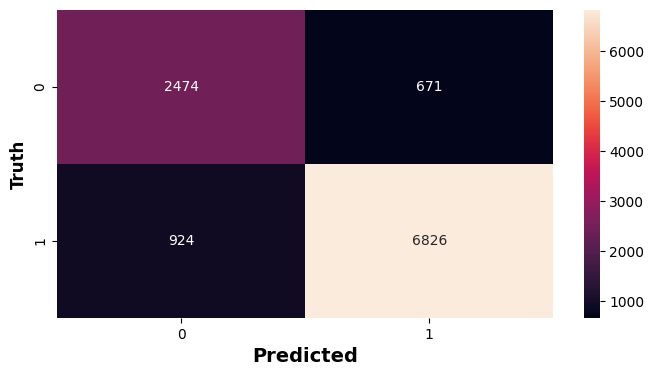

In [132]:
conf_mat(ada_best_estimator, X_test, y_test)

In [133]:
ploty_ROC(ada_best_estimator,X_test,y_test,graph_attributes)

## Graddient Boosting

Best Hyperparam -> `n_estimator: 425, max_depth: 11`

In [134]:
from sklearn.ensemble import GradientBoostingClassifier
gradBoost_all = GradientBoostingClassifier(n_estimators=425,max_depth=11,random_state=0)
gradBoost_all.fit(X_train, y_train)
y_pred = gradBoost_all.predict(X_test)

In [135]:
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
print(classification_report(y_test,y_pred))
print("Accuracy: ",accuracy_score(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.87      0.83      0.85      3145
           1       0.93      0.95      0.94      7750

    accuracy                           0.91     10895
   macro avg       0.90      0.89      0.89     10895
weighted avg       0.91      0.91      0.91     10895

Accuracy:  0.9137218907755851


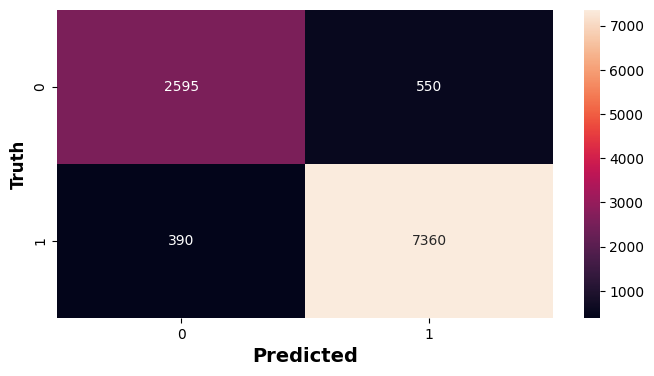

In [136]:
conf_mat(gradBoost_all, X_test, y_test)

In [137]:
ploty_ROC(gradBoost_all,X_test,y_test,graph_attributes)

## XG Boosting
Best Hyperparam -> `n_estimator: 146`

In [138]:
import xgboost as xgb
xgb_estimator = xgb.XGBClassifier(n_estimators=146,random_state=0)
xgb_estimator.fit(X_train.values,y_train.values)
y_pred = xgb_estimator.predict(X_test.values)
print("Accuracy: ",accuracy_score(y_test, y_pred))

Accuracy:  0.9059201468563561


In [139]:
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
print(classification_report(y_test,y_pred))
print("Accuracy: ",accuracy_score(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.85      0.81      0.83      3145
           1       0.93      0.94      0.93      7750

    accuracy                           0.91     10895
   macro avg       0.89      0.88      0.88     10895
weighted avg       0.90      0.91      0.91     10895

Accuracy:  0.9059201468563561


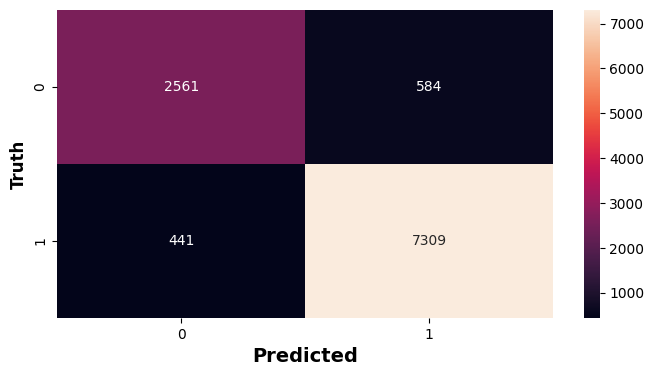

In [140]:
conf_mat(xgb_estimator, X_test, y_test)

In [141]:

ploty_ROC(xgb_estimator,X_test,y_test,graph_attributes)

## RandomForest

Best Hyperparam -> `n_estimator: 206, max_depth: 26`

In [142]:
from sklearn.ensemble import RandomForestClassifier
rf_all = RandomForestClassifier(n_estimators=206,max_depth=26,random_state=0)
rf_all.fit(X_train, y_train)
y_pred=rf_all.predict(X_test)
print("Accuracy: ",accuracy_score(y_test, y_pred))

Accuracy:  0.9020651675080312


In [143]:
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
print(classification_report(y_test,y_pred))
print("Accuracy: ",accuracy_score(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.83      0.83      0.83      3145
           1       0.93      0.93      0.93      7750

    accuracy                           0.90     10895
   macro avg       0.88      0.88      0.88     10895
weighted avg       0.90      0.90      0.90     10895

Accuracy:  0.9020651675080312


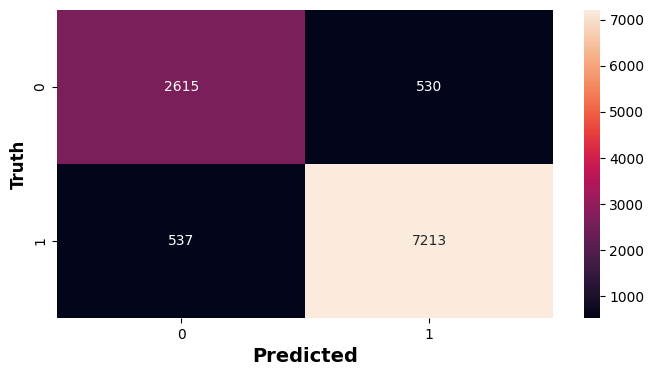

In [144]:
conf_mat(rf_all, X_test, y_test)

In [145]:
ploty_ROC(rf_all,X_test,y_test,graph_attributes)

## KNN

Best Hyperparam -> `neighbors: 1`

In [146]:
from sklearn.neighbors import KNeighborsClassifier
knn_neighbors = KNeighborsClassifier(n_neighbors=1)
knn_neighbors.fit(X_train, y_train)
y_pred=knn_neighbors.predict(X_test)


from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
print("Accuracy: ",accuracy_score(y_test, y_pred))

Accuracy:  0.8639743001376778


In [147]:
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
print(classification_report(y_test,y_pred))
print("Accuracy: ",accuracy_score(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.73      0.85      0.78      3145
           1       0.93      0.87      0.90      7750

    accuracy                           0.86     10895
   macro avg       0.83      0.86      0.84     10895
weighted avg       0.87      0.86      0.87     10895

Accuracy:  0.8639743001376778


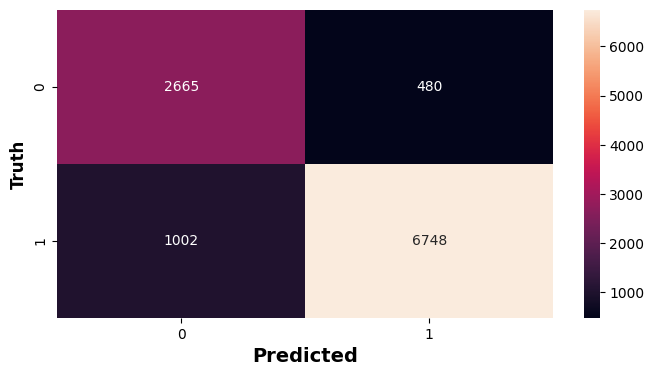

In [148]:
conf_mat(knn_neighbors, X_test, y_test)

In [149]:

ploty_ROC(knn_neighbors,X_test,y_test,graph_attributes)

## Gaussian Naïve Bayes
Best Hyperparam -> `default`

In [150]:

from sklearn.naive_bayes import GaussianNB

nb_deafult = GaussianNB()
nb_deafult.fit(X_train, y_train)
y_pred = nb_deafult.predict(X_test)

In [151]:
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
print(classification_report(y_test,y_pred))
print("Accuracy: ",accuracy_score(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.29      0.97      0.45      3145
           1       0.80      0.06      0.10      7750

    accuracy                           0.32     10895
   macro avg       0.55      0.51      0.28     10895
weighted avg       0.65      0.32      0.20     10895

Accuracy:  0.31831115190454334


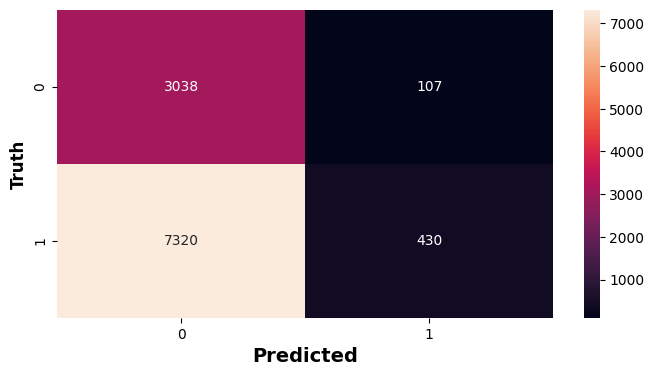

In [152]:
conf_mat(nb_deafult, X_test, y_test)

In [153]:
ploty_ROC(nb_deafult,X_test,y_test,graph_attributes)

## Histogram Boosting

Best Hyperparam -> `n_estimator: 440, max_depth: 16`

In [154]:
from sklearn.ensemble import HistGradientBoostingClassifier
his_all = HistGradientBoostingClassifier(max_iter=440,max_depth=16,random_state=0)
his_all.fit(X_train, y_train)
y_pred=his_all.predict(X_test)

In [155]:
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
print(classification_report(y_test,y_pred))
print("Accuracy: ",accuracy_score(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.86      0.82      0.84      3145
           1       0.93      0.94      0.94      7750

    accuracy                           0.91     10895
   macro avg       0.89      0.88      0.89     10895
weighted avg       0.91      0.91      0.91     10895

Accuracy:  0.9076640660853602


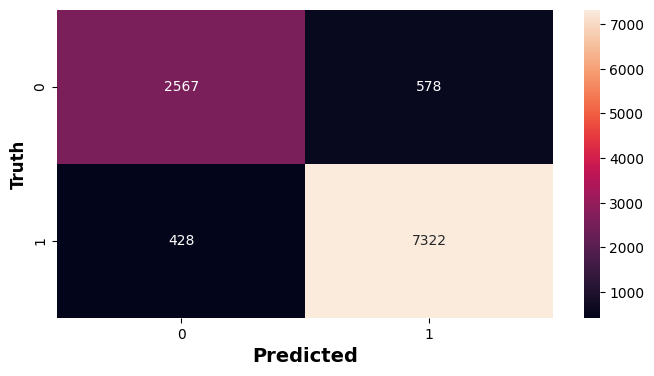

In [156]:
conf_mat(his_all, X_test, y_test)

In [157]:
ploty_ROC(his_all,X_test,y_test,graph_attributes)

# Explainable AI(XAI)
`Local  Interpretable Model-agnostic Explanations`

In [42]:
!pip install lime

     -------------------------------------- 275.7/275.7 kB 1.2 MB/s eta 0:00:00
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
     -------------------------------------- 24.5/24.5 MB 248.3 kB/s eta 0:00:00
     ------------------------------------ 313.2/313.2 kB 717.9 kB/s eta 0:00:00
     ------------------------------------ 222.9/222.9 kB 544.0 kB/s eta 0:00:00
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283843 sha256=fe747a0639ef63dd94e356323c64386bc3d9845986a46c56817d9e56f860646a
  Stored in directory: c:\users\razer\appdata\local\pip\cache\wheels\6e\ad\de\6e1f2abd50acd8aa9a4c6f2a5201cc8700099ce184922e8724
Successfully built lime


In [104]:
import lime
from lime import lime_tabular

def LIME_EXP(model,row,num_features,top_labels):

    if str(model)[:3] == "XGB":

      explainer = lime.lime_tabular.LimeTabularExplainer(
        X_train.values,
        feature_names=list(list(X_train.columns)),                                         
        class_names=['Deep_Sleep', 'Light_Sleep'],
        mode='classification'
        )
      
      exp = explainer.explain_instance(X_test.iloc[row, :].values,
                                model.predict_proba,
                                num_features=num_features,
                                top_labels=top_labels)




    else:
      explainer = lime_tabular.LimeTabularExplainer(
        training_data=np.array(X_train),
        feature_names=list(X_train.columns),
        class_names=['Deep_Sleep', 'Light_Sleep'],
        mode='classification'
        )

      exp = explainer.explain_instance(X_test.iloc[row],
                                    model.predict_proba,               
                                    num_features=num_features,
                                    top_labels=top_labels)
    


    exp.show_in_notebook(show_table=True, show_all=True)



    from IPython.display import HTML
    html_data = exp.as_html()
    HTML(data=html_data)

    exp.save_to_file(str(model)[0:10]+"_"+str(row)+".html")

## AdaBoost

In [105]:

row =  10

num_features,top_labels = 6,4
LIME_EXP(ada_best_estimator,row,num_features,top_labels)

c:\Users\RAZER\anaconda3\envs\TitanoBoa\lib\site-packages\sklearn\base.py:409: UserWarning: X does not have valid feature names, but AdaBoostClassifier was fitted with feature names
  warnings.warn(


In [106]:

row =  21

num_features,top_labels = 6,4
LIME_EXP(ada_best_estimator,row,num_features,top_labels)

c:\Users\RAZER\anaconda3\envs\TitanoBoa\lib\site-packages\sklearn\base.py:409: UserWarning: X does not have valid feature names, but AdaBoostClassifier was fitted with feature names
  warnings.warn(


## Gradient Boosting

In [107]:

row =  21

num_features,top_labels = 6,4
LIME_EXP(gradBoost_all,row,num_features,top_labels)

c:\Users\RAZER\anaconda3\envs\TitanoBoa\lib\site-packages\sklearn\base.py:409: UserWarning: X does not have valid feature names, but GradientBoostingClassifier was fitted with feature names
  warnings.warn(


## XG Boosting

In [108]:

row =  10

num_features,top_labels = 6,4
LIME_EXP(xgb_estimator,row,num_features,top_labels)

In [109]:
row =  21

num_features,top_labels = 6,4
LIME_EXP(xgb_estimator,row,num_features,top_labels)

## RandomForest

In [110]:

row =  10

num_features,top_labels = 6,4
LIME_EXP(rf_all,row,num_features,top_labels)

c:\Users\RAZER\anaconda3\envs\TitanoBoa\lib\site-packages\sklearn\base.py:409: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


In [111]:

row =  21

num_features,top_labels = 6,4
LIME_EXP(rf_all,row,num_features,top_labels)

c:\Users\RAZER\anaconda3\envs\TitanoBoa\lib\site-packages\sklearn\base.py:409: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


## KNN

In [112]:

row =  10

num_features,top_labels = 6,4
LIME_EXP(knn_neighbors,row,num_features,top_labels)

c:\Users\RAZER\anaconda3\envs\TitanoBoa\lib\site-packages\sklearn\base.py:409: UserWarning: X does not have valid feature names, but KNeighborsClassifier was fitted with feature names
  warnings.warn(


In [113]:
row =  21

num_features,top_labels = 6,4
LIME_EXP(knn_neighbors,row,num_features,top_labels)

c:\Users\RAZER\anaconda3\envs\TitanoBoa\lib\site-packages\sklearn\base.py:409: UserWarning: X does not have valid feature names, but KNeighborsClassifier was fitted with feature names
  warnings.warn(


## Gaussian Naive Bayes

In [114]:

row =  10

num_features,top_labels = 6,4
LIME_EXP(nb_deafult,row,num_features,top_labels)

c:\Users\RAZER\anaconda3\envs\TitanoBoa\lib\site-packages\sklearn\base.py:409: UserWarning: X does not have valid feature names, but GaussianNB was fitted with feature names
  warnings.warn(


In [115]:
row =  21

num_features,top_labels = 6,4
LIME_EXP(nb_deafult,row,num_features,top_labels)

c:\Users\RAZER\anaconda3\envs\TitanoBoa\lib\site-packages\sklearn\base.py:409: UserWarning: X does not have valid feature names, but GaussianNB was fitted with feature names
  warnings.warn(


## Histogram Boosting

In [116]:

row =  10

num_features,top_labels = 6,4
LIME_EXP(his_all,row,num_features,top_labels)

c:\Users\RAZER\anaconda3\envs\TitanoBoa\lib\site-packages\sklearn\base.py:409: UserWarning: X does not have valid feature names, but HistGradientBoostingClassifier was fitted with feature names
  warnings.warn(


In [117]:
row =  21

num_features,top_labels = 6,4
LIME_EXP(his_all,row,num_features,top_labels)

c:\Users\RAZER\anaconda3\envs\TitanoBoa\lib\site-packages\sklearn\base.py:409: UserWarning: X does not have valid feature names, but HistGradientBoostingClassifier was fitted with feature names
  warnings.warn(
